In [4]:
#Imports
import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt

import seaborn as sns

warnings.filterwarnings('ignore')

plt.style.use('fivethirtyeight')


In [29]:
df = pd.read_csv("../data/kickstarter_common.csv")

df.columns.value_counts
df.nunique()

id              331368
name            329292
category            15
subcategory        159
country             22
launched        330948
deadline          3102
goal             24833
pledged          39064
backers           3926
state                2
duration            91
launch_month        12
launch_year          9
dtype: int64

In [14]:
df.isna().value_counts()


id     name   category  subcategory  country  launched  deadline  goal   pledged  backers  state  duration  launch_month  launch_year
False  False  False     False        False    False     False     False  False    False    False  False     False         False          331368
Name: count, dtype: int64

In [30]:
# Write the dataframe for modelling to a clean one
df_clean=pd.read_csv("../data/kickstarter_common.csv")

# Recalculate pledge_ratio and pledge_backer ratio as new features
df_clean['pledge_ratio'] = df_clean['pledged'] / df_clean['goal']
df_clean['ave_backer'] = df_clean['pledged'] / df_clean['backers']
df_clean['backer_ratio_on_goal'] = (df_clean['goal']*df_clean['backers']) / df_clean['pledged']

# Ersetze inf/-inf durch NaN (damit wir sie anschließend ersetzen können)
df_clean.replace([np.inf, -np.inf], np.nan, inplace=True)

# Ersetze alle NaN-Werte in den betroffenen Spalten durch 0
df_clean['ave_backer'].fillna(0, inplace=True)
df_clean['backer_ratio_on_goal'].fillna(0, inplace=True)

# Prüfung: Anzahl der verbleibenden NaNs oder infs
remaining_nans = df_clean[['ave_backer', 'backer_ratio_on_goal']].isna().sum()
remaining_infs = ((df_clean[['ave_backer', 'backer_ratio_on_goal']] == np.inf) | 
                  (df_clean[['ave_backer', 'backer_ratio_on_goal']] == -np.inf)).sum()

remaining_nans, remaining_infs

(ave_backer              0
 backer_ratio_on_goal    0
 dtype: int64,
 ave_backer              0
 backer_ratio_on_goal    0
 dtype: int64)

In [32]:
df.columns

Index(['id', 'name', 'category', 'subcategory', 'country', 'launched',
       'deadline', 'goal', 'pledged', 'backers', 'state', 'duration',
       'launch_month', 'launch_year'],
      dtype='object')

In [16]:
# Show head of clean dataframe with new features 
df_clean.head()


,id,name,category,subcategory,country,launched,deadline,goal,pledged,backers,state,duration,launch_month,launch_year,pledge_ratio,ave_backer,backer_ratio_on_goal
0,1860890148,Grace Jones Does Not Give A F$#% T-Shirt (limi...,Fashion,Fashion,United States,2009-04-21 21:02:48,2009-05-31,1000,625,30,Failed,39,4,2009,0.625000,20.833333,48.000000
1,709707365,CRYSTAL ANTLERS UNTITLED MOVIE,Film & Video,Shorts,United States,2009-04-23 00:07:53,2009-07-20,80000,22,3,Failed,87,4,2009,0.000275,7.333333,10909.090909
2,1703704063,drawing for dollars,Art,Illustration,United States,2009-04-24 21:52:03,2009-05-03,20,35,3,Successful,8,4,2009,1.750000,11.666667,1.714286
3,727286,Offline Wikipedia iPhone app,Technology,Software,United States,2009-04-25 17:36:21,2009-07-14,99,145,25,Successful,79,4,2009,1.464646,5.800000,17.068966
4,1622952265,Pantshirts,Fashion,Fashion,United States,2009-04-27 14:10:39,2009-05-26,1900,387,10,Failed,28,4,2009,0.203684,38.700000,49.095607


In [33]:
print(df_clean.info())
df_clean.describe(include='all')


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 331368 entries, 0 to 331367
Data columns (total 17 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    331368 non-null  int64  
 1   name                  331368 non-null  object 
 2   category              331368 non-null  object 
 3   subcategory           331368 non-null  object 
 4   country               331368 non-null  object 
 5   launched              331368 non-null  object 
 6   deadline              331368 non-null  object 
 7   goal                  331368 non-null  int64  
 8   pledged               331368 non-null  int64  
 9   backers               331368 non-null  int64  
 10  state                 331368 non-null  object 
 11  duration              331368 non-null  int64  
 12  launch_month          331368 non-null  int64  
 13  launch_year           331368 non-null  int64  
 14  pledge_ratio          331368 non-null  float64
 15  

,id,name,category,subcategory,country,launched,deadline,goal,pledged,backers,state,duration,launch_month,launch_year,pledge_ratio,ave_backer,backer_ratio_on_goal
count,3.313680e+05,331368,331368,331368,331368,331368,331368,3.313680e+05,3.313680e+05,331368.000000,331368,331368.000000,331368.000000,331368.000000,331368.000000,331368.000000,3.313680e+05
unique,NaN,329292,15,159,22,330948,3102,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,New EP/Music Development,Film & Video,Product Design,United States,2017-09-06 17:14:01,2014-08-08,NaN,NaN,NaN,Failed,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,13,56491,18678,261290,2,612,NaN,NaN,NaN,197553,NaN,NaN,NaN,NaN,NaN,NaN
mean,1.074274e+09,NaN,NaN,NaN,NaN,NaN,NaN,4.119947e+04,9.942576e+03,116.485171,NaN,32.965111,6.417874,2014.178898,3.467244,66.137043,6.616915e+03
std,6.192029e+08,NaN,NaN,NaN,NaN,NaN,NaN,1.095625e+06,9.665918e+04,965.868090,NaN,12.703893,3.307194,1.931015,281.913144,131.631359,5.516147e+05
min,5.971000e+03,NaN,NaN,NaN,NaN,NaN,NaN,1.000000e+00,0.000000e+00,0.000000,NaN,1.000000,1.000000,2009.000000,0.000000,0.000000,0.000000e+00
25%,5.371489e+08,NaN,NaN,NaN,NaN,NaN,NaN,2.000000e+03,5.000000e+01,2.000000,NaN,29.000000,4.000000,2013.000000,0.007500,16.809524,2.454245e+01
50%,1.074686e+09,NaN,NaN,NaN,NaN,NaN,NaN,5.000000e+03,7.890000e+02,15.000000,NaN,29.000000,6.000000,2014.000000,0.200000,42.357054,8.185223e+01
75%,1.609843e+09,NaN,NaN,NaN,NaN,NaN,NaN,1.500000e+04,4.610250e+03,63.000000,NaN,35.000000,9.000000,2016.000000,1.095000,77.583567,2.597403e+02


In [17]:
df_clean.isnull().value_counts()



id     name   category  subcategory  country  launched  deadline  goal   pledged  backers  state  duration  launch_month  launch_year  pledge_ratio  ave_backer  backer_ratio_on_goal
False  False  False     False        False    False     False     False  False    False    False  False     False         False        False         False       False                   331368
Name: count, dtype: int64

In [18]:
df_clean[df_clean['pledge_ratio'].isna()]

,id,name,category,subcategory,country,launched,deadline,goal,pledged,backers,state,duration,launch_month,launch_year,pledge_ratio,ave_backer,backer_ratio_on_goal


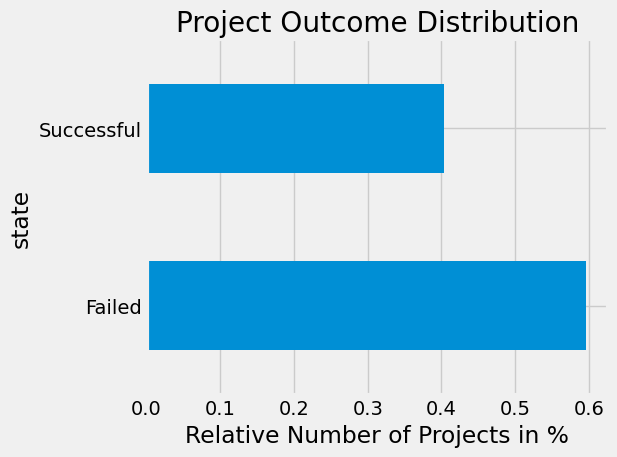

In [34]:
ax = df_clean['state'].value_counts(normalize=True).plot(kind='barh', title='Project Outcome Distribution')

# Add x-axis label
ax.set_xlabel('Relative Number of Projects in %')

plt.tight_layout()
plt.show()

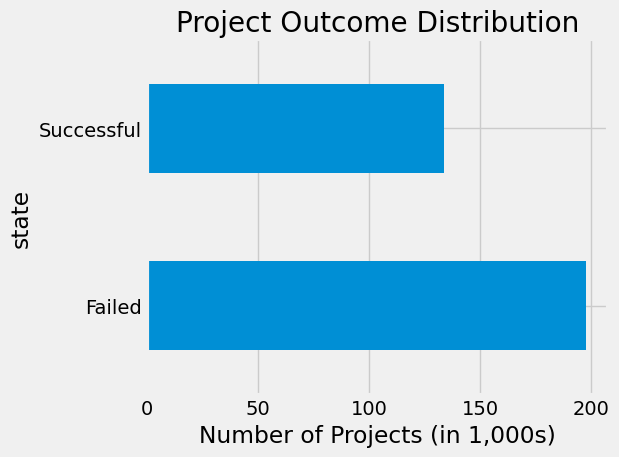

In [19]:

ax = df_clean['state'].value_counts(normalize=False).plot(
    kind='barh',
    title='Project Outcome Distribution'
    )

# Set custom ticks manually
max_value = df_clean['state'].value_counts().max()
ticks = list(range(0, max_value + 50000, 50000))
labels = [str(int(t / 1000)) for t in ticks]

ax.set_xticks(ticks)
ax.set_xticklabels(labels)

# Add x-axis label
ax.set_xlabel('Number of Projects (in 1,000s)')

plt.tight_layout()
plt.show()

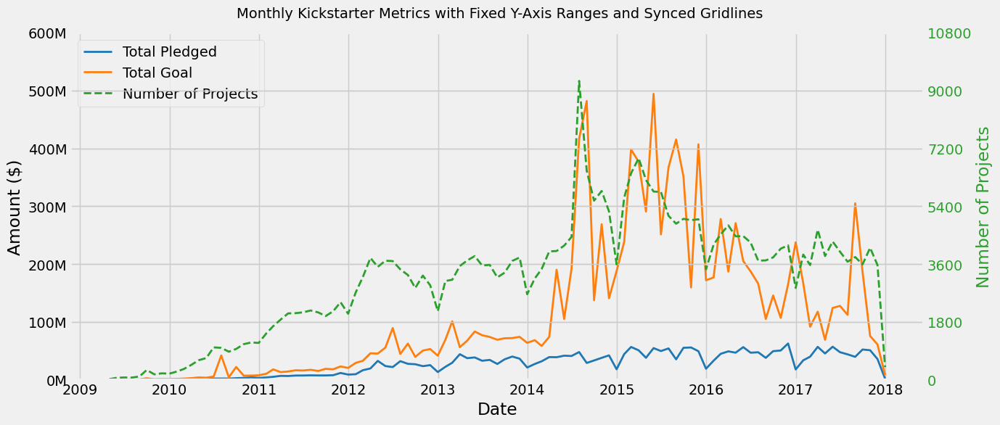

In [35]:
# launched zu datetime konvertieren
df_clean['launched'] = pd.to_datetime(df_clean['launched'], errors='coerce')

# Monatsweise Aggregation: Summe von pledged & goal, Anzahl der Projekte (id zählt einfach Zeilen)
monthly_stats = df_clean.groupby(pd.Grouper(key='launched', freq='M')).agg({
    'pledged': 'sum',
    'goal': 'sum',
    'id': 'count'  # Anzahl Projekte pro Monat
}).reset_index()

# Umbenennen für Plot-Kompatibilität
monthly_stats.rename(columns={'launched': 'date'}, inplace=True)

# Plot mit zwei y-Achsen
fig, ax1 = plt.subplots(figsize=(14, 6))

# Primäre y-Achse: pledged und goal
ax1.plot(monthly_stats['date'], monthly_stats['pledged'], label='Total Pledged', color='tab:blue', linewidth=2)
ax1.plot(monthly_stats['date'], monthly_stats['goal'], label='Total Goal', color='tab:orange', linewidth=2)
ax1.set_xlabel('Date')
ax1.set_ylabel('Amount ($)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

# Linke Achse: fixe Skalierung und Tickmarks
ax1.set_ylim(0, 6e8)
ax1.set_yticks(np.linspace(0, 7e8, 7))
ax1.set_yticklabels([f'{int(tick/1e6)}M' for tick in np.linspace(0, 6e8, 7)])

# Sekundäre y-Achse: Projektanzahl
ax2 = ax1.twinx()
ax2.plot(monthly_stats['date'], monthly_stats['id'], label='Number of Projects', color='tab:green', linewidth=2, linestyle='--')
ax2.set_ylabel('Number of Projects', color='tab:green')
ax2.tick_params(axis='y', labelcolor='tab:green')

# Rechte Achse: fixe Skalierung und Tickmarks
ax2.set_ylim(0, 9000)
ax2.set_yticks(np.linspace(0, 10800, 7).astype(int))


# Titel, Layout & Grid
fig.suptitle('Monthly Kickstarter Metrics with Fixed Y-Axis Ranges and Synced Gridlines', fontsize=14)
fig.tight_layout()
fig.subplots_adjust(top=0.92)
ax1.grid(True)

# Gemeinsame Legende
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

plt.show()

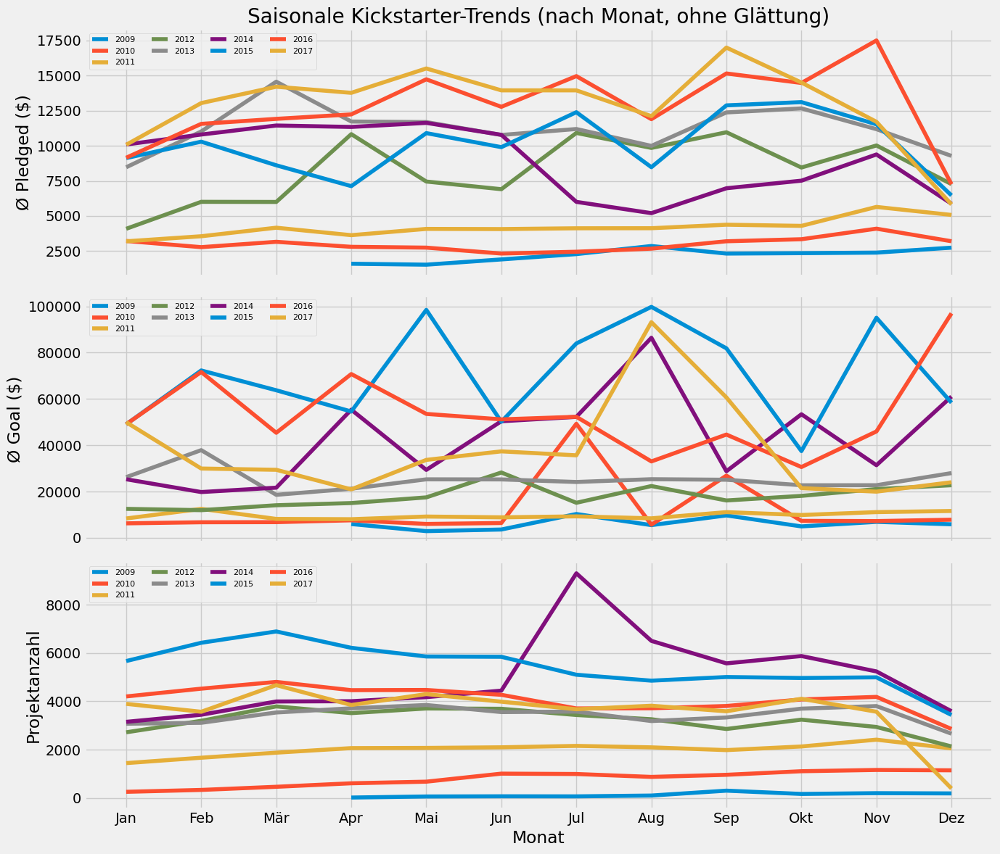

In [195]:
# Sicherstellen, dass 'launched' datetime ist
df_clean['launched'] = pd.to_datetime(df_clean['launched'], errors='coerce')

# Monat und Jahr extrahieren
df_clean['launch_month'] = df_clean['launched'].dt.month
df_clean['launch_year'] = df_clean['launched'].dt.year

# Durchschnittswerte pro Monat für jede Kennzahl, gruppiert nach Jahr
monthly_trends = df_clean.groupby(['launch_year', 'launch_month']).agg({
    'pledged': 'mean',
    'goal': 'mean',
    'id': 'count'  # Anzahl Projekte
}).reset_index()

# Plot: Entwicklung je Monat pro Jahr
fig, axs = plt.subplots(3, 1, figsize=(14, 12), sharex=True)

for year in sorted(monthly_trends['launch_year'].unique()):
    data = monthly_trends[monthly_trends['launch_year'] == year]
    axs[0].plot(data['launch_month'], data['pledged'], label=str(year))
    axs[1].plot(data['launch_month'], data['goal'], label=str(year))
    axs[2].plot(data['launch_month'], data['id'], label=str(year))

# Achsenbeschriftungen
axs[0].set_ylabel('Ø Pledged ($)')
axs[1].set_ylabel('Ø Goal ($)')
axs[2].set_ylabel('Projektanzahl')
axs[2].set_xlabel('Monat')
axs[0].set_title('Saisonale Kickstarter-Trends (nach Monat, ohne Glättung)')

# Monatsnamen optional
axs[2].set_xticks(range(1, 13))
axs[2].set_xticklabels(['Jan', 'Feb', 'Mär', 'Apr', 'Mai', 'Jun', 'Jul', 'Aug', 'Sep', 'Okt', 'Nov', 'Dez'])

# Legende & Grid
for ax in axs:
    ax.grid(True)
    ax.legend(loc='upper left', ncol=4, fontsize=8)

plt.tight_layout()
plt.show()

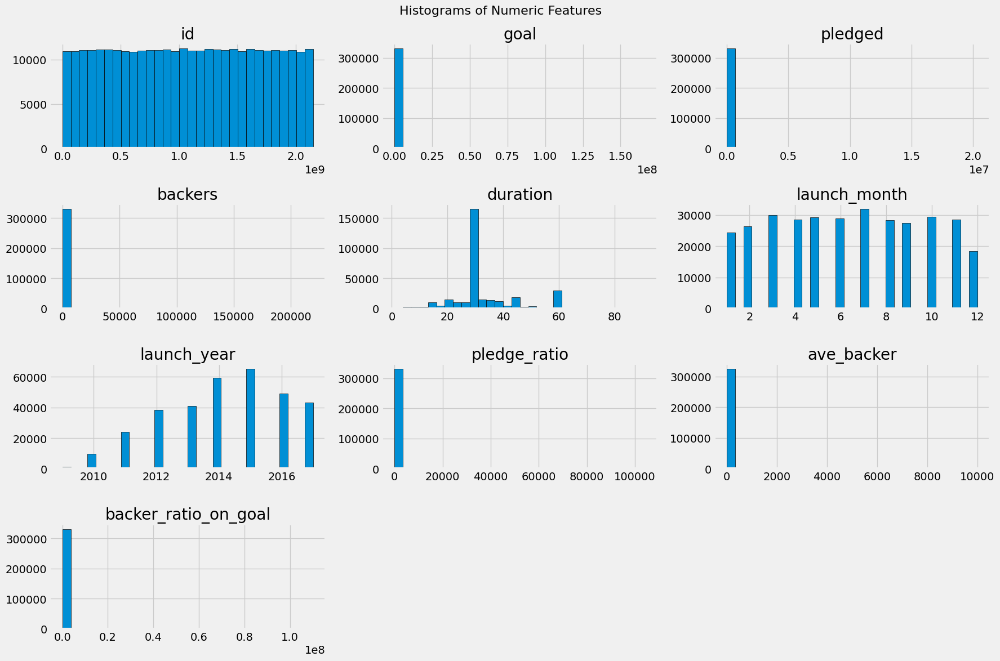

In [36]:
# Get numeric columns only
numeric_cols = df_clean.select_dtypes(include=['number']).columns

# Replace inf and -inf with NaN
df_numeric = df_clean[numeric_cols].replace([np.inf, -np.inf], np.nan)

# Drop rows with any NaNs (which includes the replaced infs)
df_numeric = df_numeric.dropna()

# Now plot
df_numeric.hist(bins=30, figsize=(18, 12), edgecolor='black')
plt.suptitle("Histograms of Numeric Features", fontsize=16)
plt.tight_layout()
plt.show()

In [37]:
df_clean.columns

Index(['id', 'name', 'category', 'subcategory', 'country', 'launched',
       'deadline', 'goal', 'pledged', 'backers', 'state', 'duration',
       'launch_month', 'launch_year', 'pledge_ratio', 'ave_backer',
       'backer_ratio_on_goal'],
      dtype='object')

In [38]:
df.columns

Index(['id', 'name', 'category', 'subcategory', 'country', 'launched',
       'deadline', 'goal', 'pledged', 'backers', 'state', 'duration',
       'launch_month', 'launch_year'],
      dtype='object')

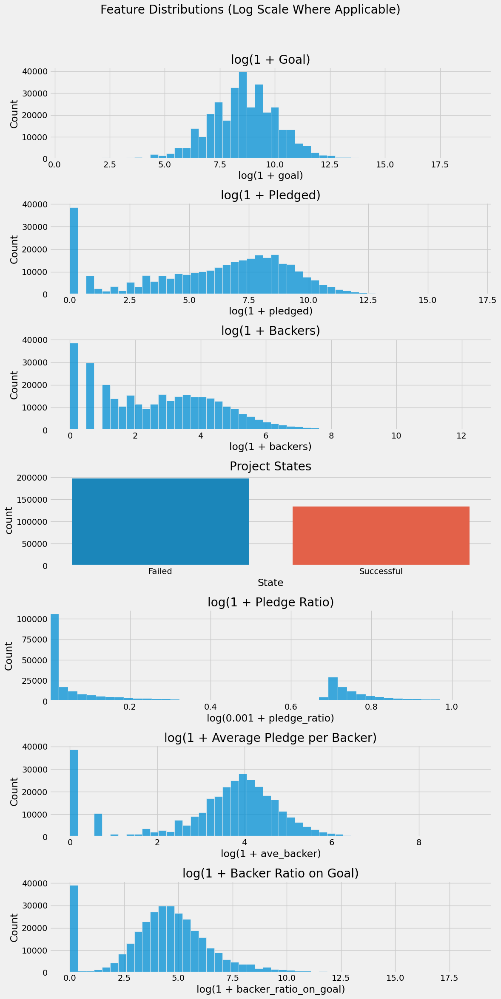

In [39]:
# Set up a vertical stack of 7 plots
fig, axs = plt.subplots(7, 1, figsize=(12, 24))
fig.suptitle("Feature Distributions (Log Scale Where Applicable)", fontsize=20)

# Plot 1: goal
sns.histplot(np.log1p(df_clean['goal']), bins=50, ax=axs[0])
axs[0].set_title('log(1 + Goal)')
axs[0].set_xlabel('log(1 + goal)')

# Plot 2: pledged
sns.histplot(np.log1p(df_clean['pledged']), bins=50, ax=axs[1])
axs[1].set_title('log(1 + Pledged)')
axs[1].set_xlabel('log(1 + pledged)')

# Plot 3: backers
sns.histplot(np.log1p(df_clean['backers']), bins=50, ax=axs[2])
axs[2].set_title('log(1 + Backers)')
axs[2].set_xlabel('log(1 + backers)')

# Plot 4: state (categorical count)
sns.countplot(x='state', data=df_clean, ax=axs[3])
axs[3].set_title('Project States')
axs[3].set_xlabel('State')

# Plot 5: pledge_ratio
sns.histplot(np.log1p(df_clean['pledge_ratio']), bins=500, ax=axs[4])
axs[4].set_title('log(1 + Pledge Ratio)')
axs[4].set_xlabel('log(0.001 + pledge_ratio)')
axs[4].set_xlim(left=1e-3, right=np.log1p(2.0))

# Plot 6: ave_backer
sns.histplot(np.log1p(df_clean['ave_backer']), bins=50, ax=axs[5])
axs[5].set_title('log(1 + Average Pledge per Backer)')
axs[5].set_xlabel('log(1 + ave_backer)')

# Plot 7: backer_ratio_on_goal
sns.histplot(np.log1p(df_clean['backer_ratio_on_goal']), bins=50, ax=axs[6])
axs[6].set_title('log(1 + Backer Ratio on Goal)')
axs[6].set_xlabel('log(1 + backer_ratio_on_goal)')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()



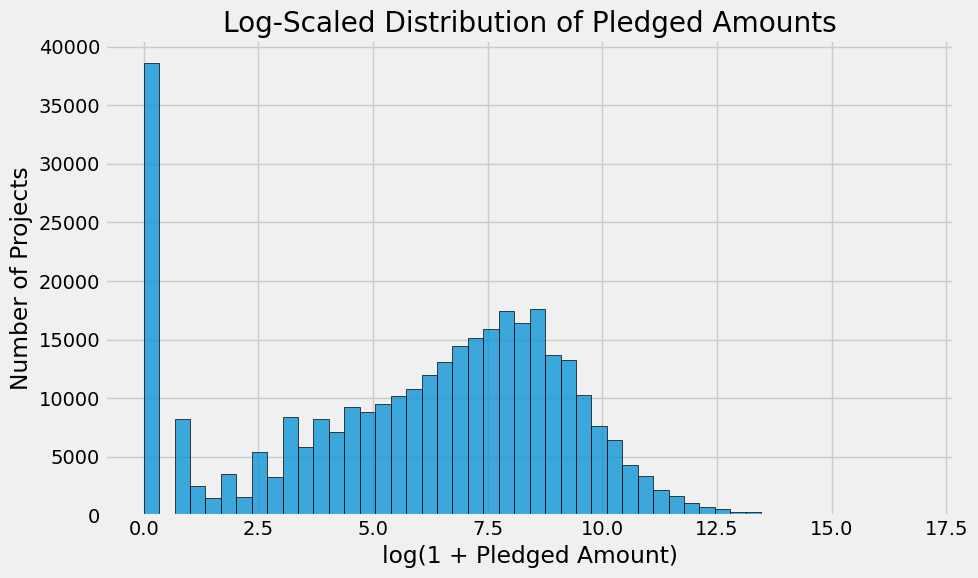

In [40]:
plt.figure(figsize=(10, 6))
sns.histplot(np.log1p(df_clean['pledged']), bins=50, edgecolor='black')
plt.title("Log-Scaled Distribution of Pledged Amounts")
plt.xlabel("log(1 + Pledged Amount)")
plt.ylabel("Number of Projects")
plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Correlation Matrix')

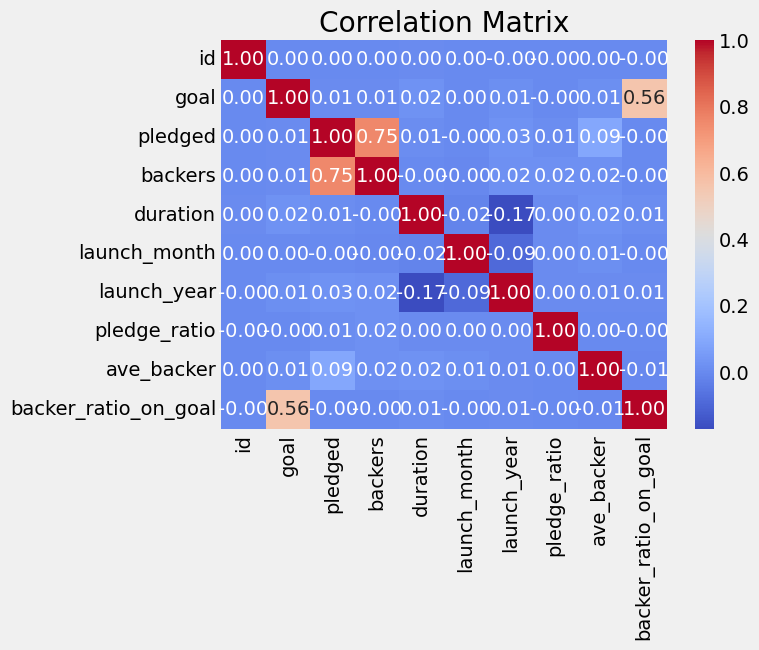

In [41]:
sns.heatmap(df_clean.corr(numeric_only=True), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix")

#pledged# is highl correlated with "backers" - so, what is the typical average pledge per baker ? I calculated this. And then also the backer ratio on goal... to see, whether higher goals are resulting on higher pledges...

In [42]:
df_clean.head()

,id,name,category,subcategory,country,launched,deadline,goal,pledged,backers,state,duration,launch_month,launch_year,pledge_ratio,ave_backer,backer_ratio_on_goal
0,1860890148,Grace Jones Does Not Give A F$#% T-Shirt (limi...,Fashion,Fashion,United States,2009-04-21 21:02:48,2009-05-31,1000,625,30,Failed,39,4,2009,0.625000,20.833333,48.000000
1,709707365,CRYSTAL ANTLERS UNTITLED MOVIE,Film & Video,Shorts,United States,2009-04-23 00:07:53,2009-07-20,80000,22,3,Failed,87,4,2009,0.000275,7.333333,10909.090909
2,1703704063,drawing for dollars,Art,Illustration,United States,2009-04-24 21:52:03,2009-05-03,20,35,3,Successful,8,4,2009,1.750000,11.666667,1.714286
3,727286,Offline Wikipedia iPhone app,Technology,Software,United States,2009-04-25 17:36:21,2009-07-14,99,145,25,Successful,79,4,2009,1.464646,5.800000,17.068966
4,1622952265,Pantshirts,Fashion,Fashion,United States,2009-04-27 14:10:39,2009-05-26,1900,387,10,Failed,28,4,2009,0.203684,38.700000,49.095607


In [202]:
#df_clean = df_clean[df_clean['state'].notna()]

#sns.pairplot(df_clean[['goal', 'pledged', 'backers', 'pledge_ratio', 'ave_backer', 'state']], hue='state')
#plt.suptitle("Pairplot by Project State", y=1.02)

Text(0.5, 1.0, 'Feature Medians by Project State')

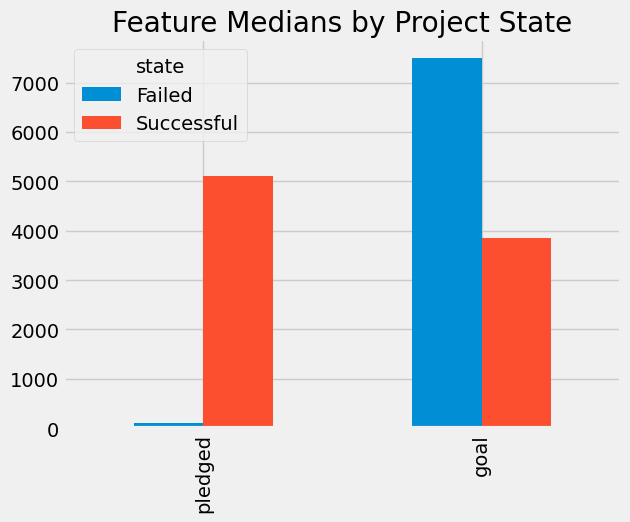

In [44]:
df_clean.groupby('state')[['pledged', 'goal']].median().T.plot(kind='bar')
plt.title("Feature Medians by Project State")

<Axes: xlabel='state'>

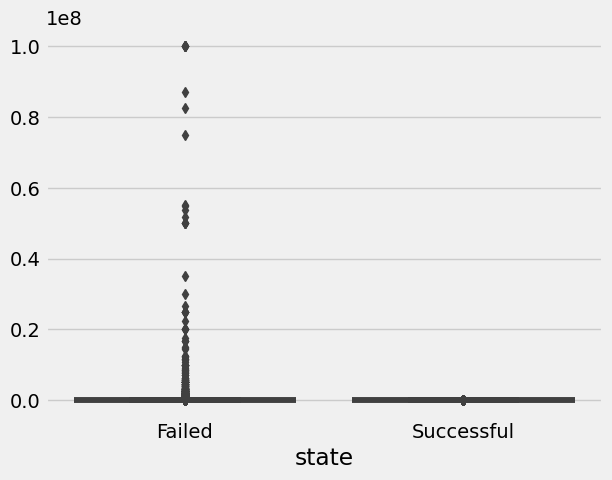

In [45]:
sns.boxplot(x='state', y=(df_clean['goal']/df_clean['backers']), data=df_clean)


<Axes: xlabel='state', ylabel='backers'>

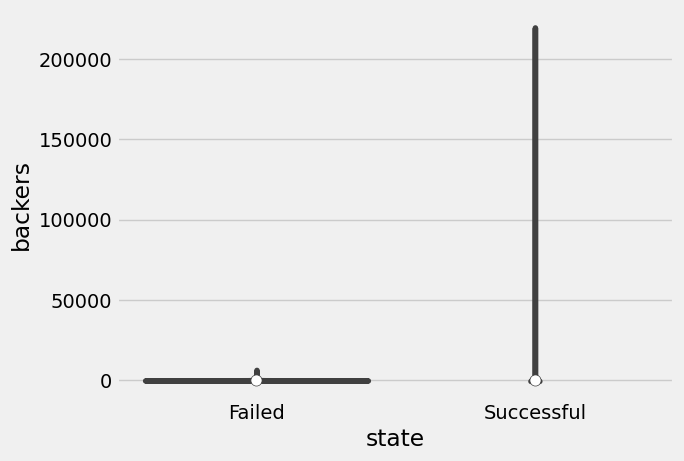

In [46]:
sns.violinplot(x='state', y='backers', data=df_clean)

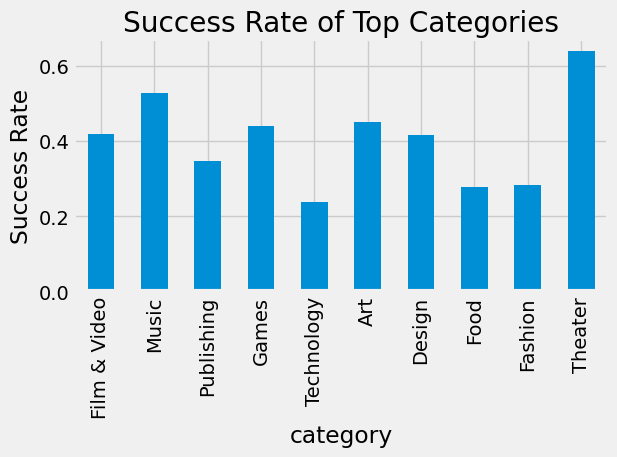

In [47]:
top_cats = df_clean['category'].value_counts().head(10)
success_counts = df_clean[df_clean['state'] == 'Successful']['category'].value_counts()

# Reindex success_counts to align with top_cats
success_rate = success_counts.reindex(top_cats.index) / top_cats

# Plot the success rates
success_rate.plot(kind='bar', title='Success Rate of Top Categories')
plt.ylabel("Success Rate")
plt.tight_layout()
plt.show()

<Axes: title={'center': 'Success Rate by Country'}, xlabel='country', ylabel='duration_days'>

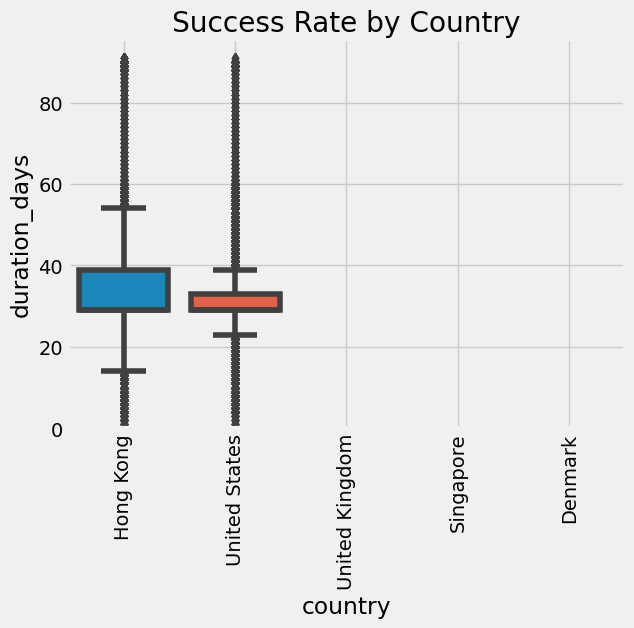

In [48]:
df_clean['launched'] = pd.to_datetime(df_clean['launched'], errors='coerce')
df_clean['deadline'] = pd.to_datetime(df_clean['deadline'], errors='coerce')

df_clean['duration_days'] = (df_clean['deadline'] - df_clean['launched']).dt.days
sns.boxplot(x='state', y='duration_days', data=df_clean)
country_success = df_clean[df_clean['state'] == 'Successful']['country'].value_counts()
country_total = df_clean['country'].value_counts()
(country_success / country_total).sort_values(ascending=False).head(5).plot(kind='bar', title='Success Rate by Country')


<Axes: title={'center': 'Projects Launched Over Time'}, xlabel='launch_month'>

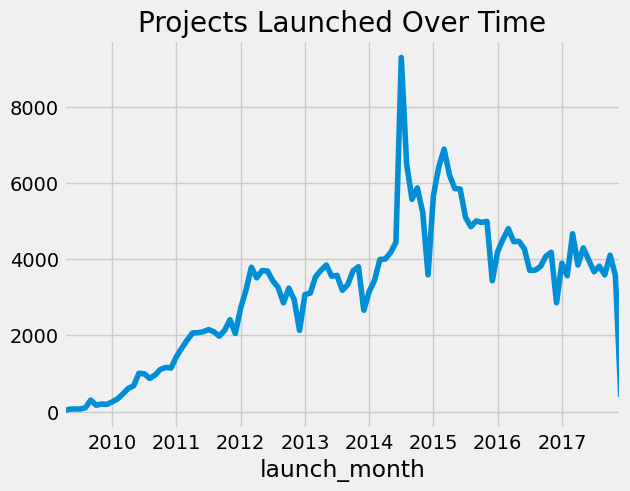

In [49]:
df_clean['launch_month'] = df_clean['launched'].dt.to_period('M')
df_clean['launch_month'].value_counts().sort_index().plot(kind='line', title='Projects Launched Over Time')

In [50]:
# Recreate launch_month just in case
df_clean['launch_month'] = pd.to_datetime(df_clean['launched'], errors='coerce').dt.to_period('M')

# Filter successful projects and drop NaNs
successful = df_clean[df_clean['state'] == 'successful'].copy()
successful = successful[successful['launch_month'].notna()]

# Count successful projects per month
success_per_month = successful['launch_month'].value_counts().sort_index()

# Only plot if data exists
if not success_per_month.empty:
    success_per_month.plot(kind='line', title='Successful Projects Over Time')
    plt.xlabel('Launch Month')
    plt.ylabel('Number of Successful Projects')
    plt.tight_layout()
    plt.show()
else:
    print("No successful projects with valid launch dates found.")

No successful projects with valid launch dates found.


<Axes: title={'center': 'Median Pledged/Goal by Category'}, xlabel='category'>

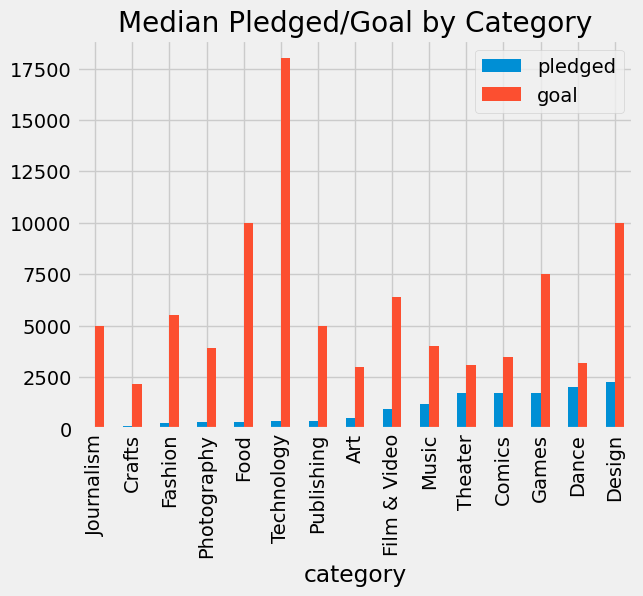

In [51]:
df_clean.groupby('category')[['pledged', 'goal']].median().sort_values('pledged').plot(kind='bar', title='Median Pledged/Goal by Category')


<Axes: xlabel='state', ylabel='category'>

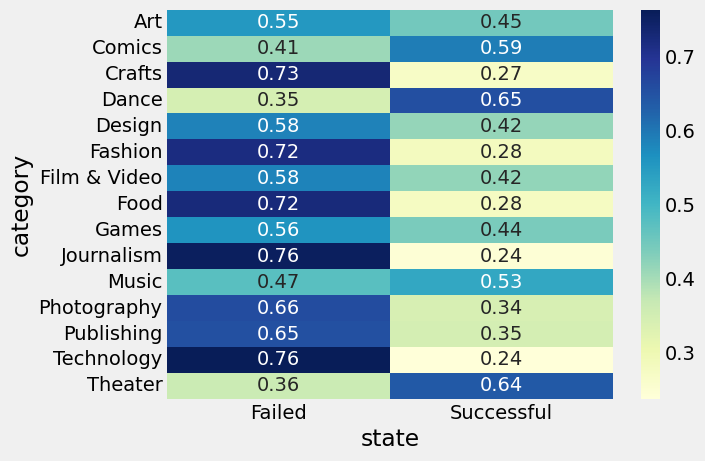

In [52]:
pivot = pd.crosstab(df_clean['category'], df_clean['state'], normalize='index')
sns.heatmap(pivot, annot=True, cmap='YlGnBu')

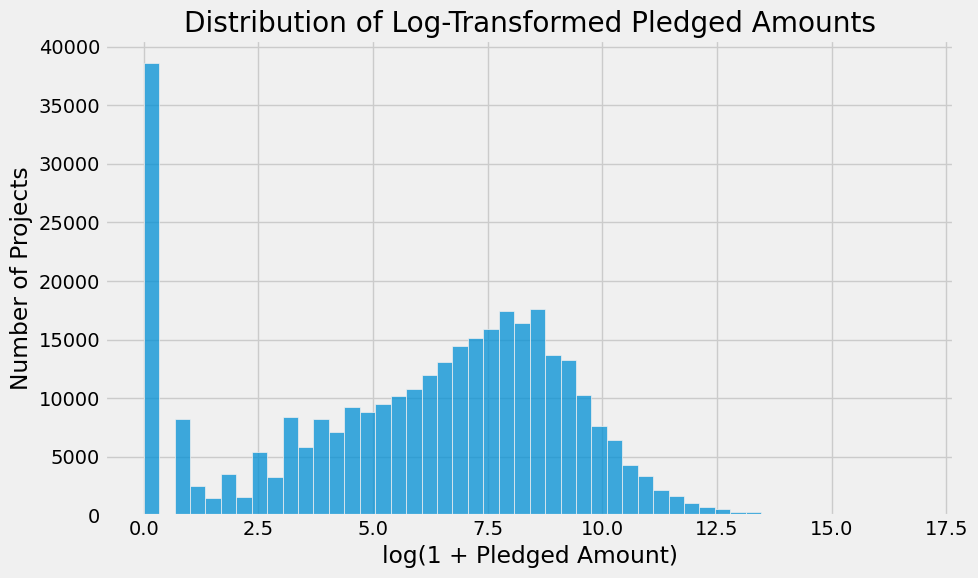

In [53]:
plt.figure(figsize=(10, 6))
sns.histplot(np.log1p(df_clean['pledged']), bins=50)
plt.title("Distribution of Log-Transformed Pledged Amounts")
plt.xlabel("log(1 + Pledged Amount)")
plt.ylabel("Number of Projects")
plt.tight_layout()
plt.show()

<Axes: xlabel='backers', ylabel='pledge_ratio'>

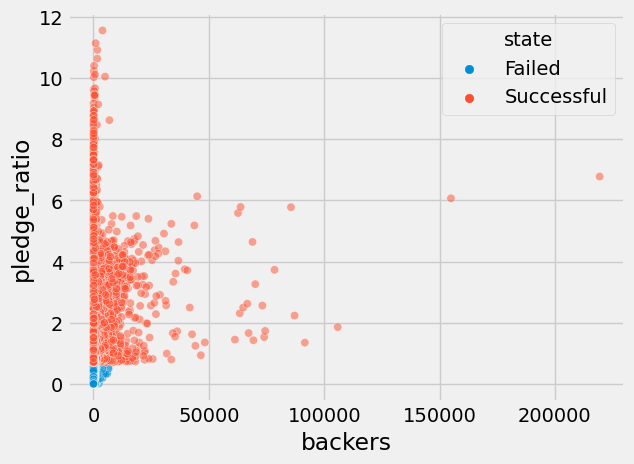

In [54]:
sns.scatterplot(x='backers', y=np.log1p(df_clean['pledge_ratio']), hue='state', data=df_clean, alpha=0.5)


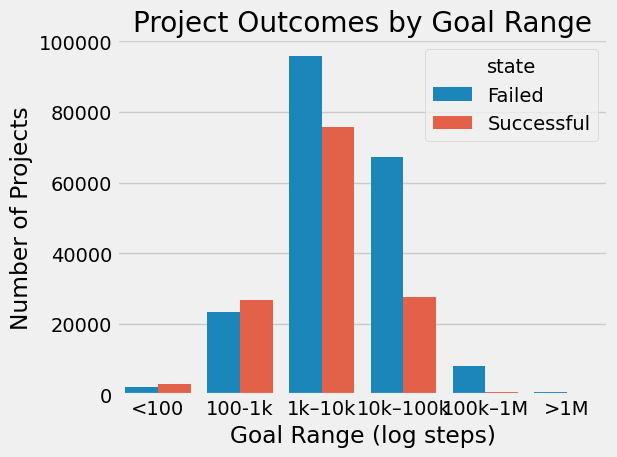

In [55]:
# Define bins and labels
goal_bins = [0, 100, 1_000, 10_000, 100_000, 1_000_000, df_clean['goal'].max()]
goal_labels = ['<100', '100-1k', '1k–10k', '10k–100k', '100k–1M', '>1M']

# Create new column
df_clean['goal_bin'] = pd.cut(df_clean['goal'], bins=goal_bins, labels=goal_labels, include_lowest=True)
sns.countplot(data=df_clean, x='goal_bin', hue='state')
plt.title("Project Outcomes by Goal Range")
plt.xlabel("Goal Range (log steps)")
plt.ylabel("Number of Projects")
plt.tight_layout()
plt.show()

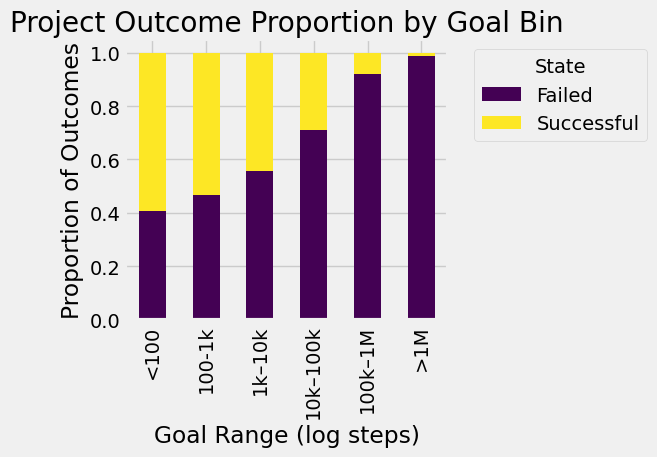

In [56]:
# Cross-tab and normalize
goal_state_dist = pd.crosstab(df_clean['goal_bin'], df_clean['state'], normalize='index')

# Plot as stacked bar
goal_state_dist.plot(kind='bar', stacked=True, colormap='viridis')
plt.title("Project Outcome Proportion by Goal Bin")
plt.xlabel("Goal Range (log steps)")
plt.ylabel("Proportion of Outcomes")
plt.legend(title='State', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

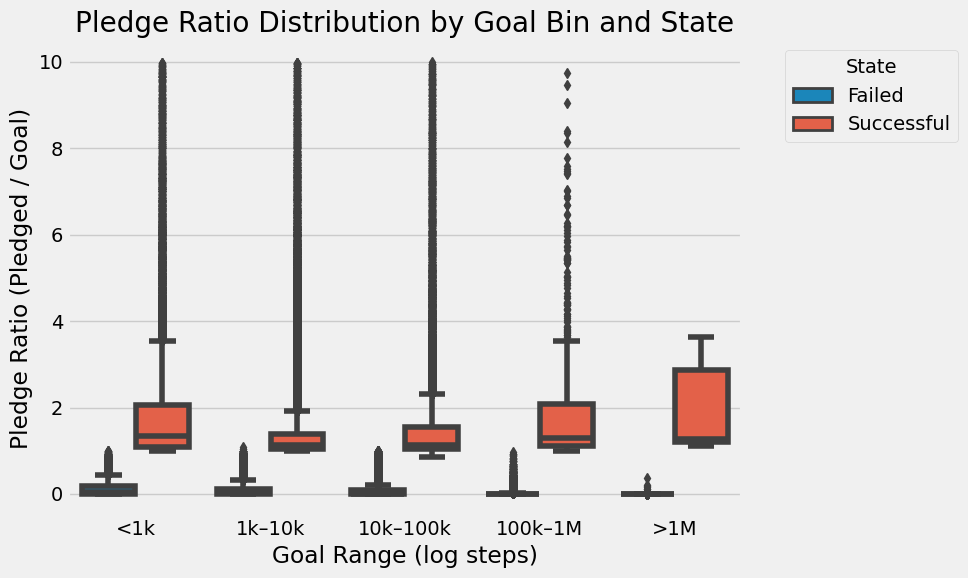

In [57]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Define log-scaled goal bins
goal_bins = [0, 1_000, 10_000, 100_000, 1_000_000, df_clean['goal'].max()]
goal_labels = ['<1k', '1k–10k', '10k–100k', '100k–1M', '>1M']

# Create the binned column (if not already created)
df_clean['goal_bin'] = pd.cut(df_clean['goal'], bins=goal_bins, labels=goal_labels, include_lowest=True)

# Remove NaNs and extreme pledge_ratio outliers (optional but recommended)
df_box = df_clean[df_clean['pledge_ratio'].notna() & df_clean['goal_bin'].notna()]
df_box = df_box[df_box['pledge_ratio'] < 10]  # Filter for visibility

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_box, x='goal_bin', y='pledge_ratio', hue='state')
plt.title('Pledge Ratio Distribution by Goal Bin and State')
plt.xlabel('Goal Range (log steps)')
plt.ylabel('Pledge Ratio (Pledged / Goal)')
plt.legend(title='State', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

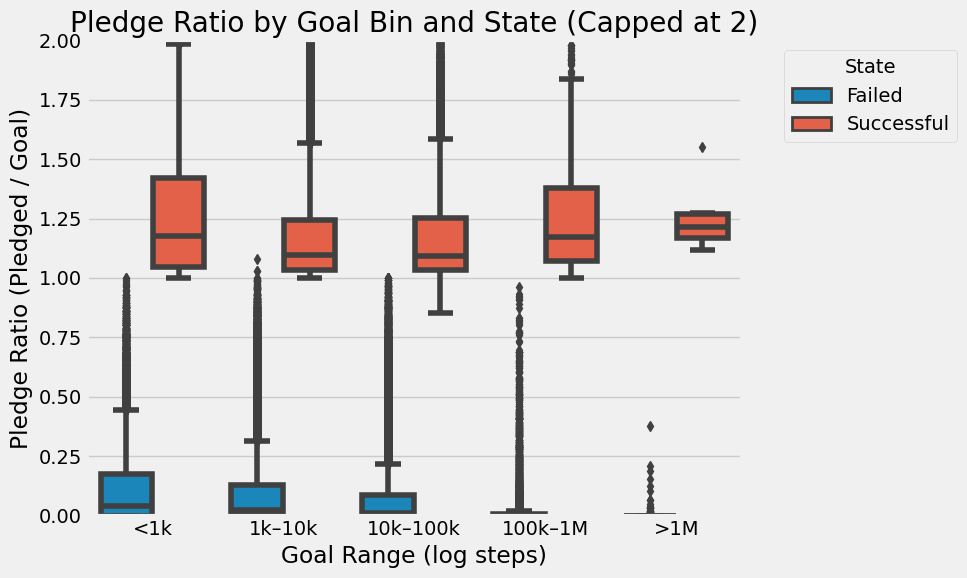

In [58]:
df_box = df_clean[df_clean['pledge_ratio'].notna() & df_clean['goal_bin'].notna()]
df_box = df_box[df_box['pledge_ratio'] <= 2]

# Define goal bins
goal_bins = [0, 1_000, 10_000, 100_000, 1_000_000, df_clean['goal'].max()]
goal_labels = ['<1k', '1k–10k', '10k–100k', '100k–1M', '>1M']
df_clean['goal_bin'] = pd.cut(df_clean['goal'], bins=goal_bins, labels=goal_labels, include_lowest=True)

# Filter data and outliers
df_box = df_clean[df_clean['pledge_ratio'].notna() & df_clean['goal_bin'].notna()]
df_box = df_box[df_box['pledge_ratio'] <= 2]

# Plot
plt.figure(figsize=(10, 6))
plt.ylim(0, 2)
sns.boxplot(data=df_box, x='goal_bin', y='pledge_ratio', hue='state')
plt.ylim(0, 2)
plt.title('Pledge Ratio by Goal Bin and State (Capped at 2)')
plt.xlabel('Goal Range (log steps)')
plt.ylabel('Pledge Ratio (Pledged / Goal)')
plt.legend(title='State', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

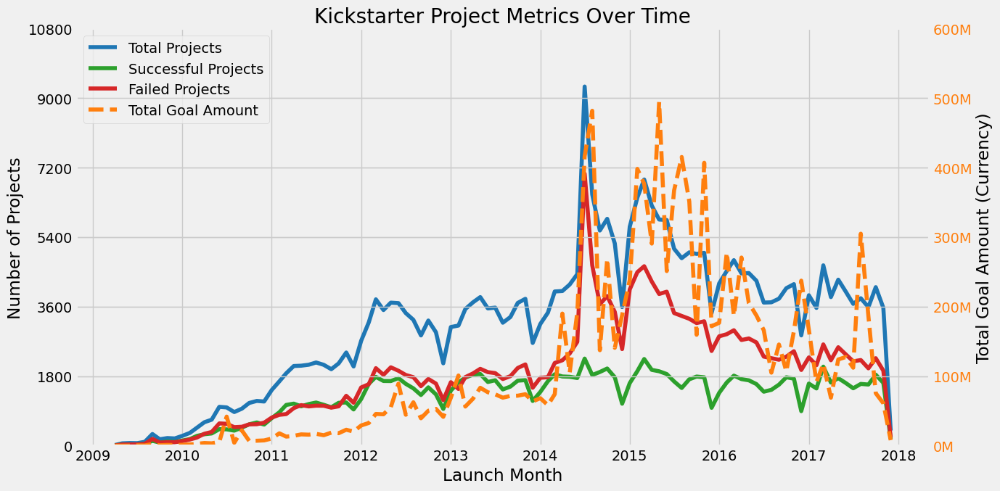

In [59]:
import matplotlib.pyplot as plt
import pandas as pd

# Ensure 'launch_month' is correct
df_clean['launch_month'] = pd.to_datetime(df_clean['launched'], errors='coerce').dt.to_period('M')

# Group by month
grouped = df_clean.groupby('launch_month')

# Metrics
total_projects = grouped.size()
total_goal = grouped['goal'].sum()
successful_projects = grouped['state'].apply(lambda x: (x == 'Successful').sum())
failed_projects = grouped['state'].apply(lambda x: (x == 'Failed').sum())

# Convert PeriodIndex to datetime for plotting
x = total_projects.index.to_timestamp()

# Plot
fig, ax1 = plt.subplots(figsize=(14, 7))

# Left y-axis
ax1.plot(x, total_projects, label='Total Projects', color='tab:blue')
ax1.plot(x, successful_projects, label='Successful Projects', color='tab:green')
ax1.plot(x, failed_projects, label='Failed Projects', color='tab:red')
ax1.set_ylabel("Number of Projects")
ax1.set_xlabel("Launch Month")
ax1.tick_params(axis='y')
ax1.legend(loc='upper left')

# Rechte Achse: fixe Skalierung und Tickmarks
ax1.set_ylim(0, 9000)
ax1.set_yticks(np.linspace(0, 10800, 7).astype(int))


# Right y-axis for total goal amount
ax2 = ax1.twinx()
ax2.plot(x, total_goal, label='Total Goal Amount', color='tab:orange', linestyle='--')
ax2.set_ylabel("Total Goal Amount (Currency)")
ax2.tick_params(axis='y', labelcolor='tab:orange')

ax2.set_ylim(0, 6e8)
ax2.set_yticks(np.linspace(0, 7e8, 7))
ax2.set_yticklabels([f'{int(tick/1e6)}M' for tick in np.linspace(0, 6e8, 7)])


# Combine legends
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='upper left')

plt.title("Kickstarter Project Metrics Over Time")
plt.tight_layout()
plt.show()

In [60]:
df_clean.columns

Index(['id', 'name', 'category', 'subcategory', 'country', 'launched',
       'deadline', 'goal', 'pledged', 'backers', 'state', 'duration',
       'launch_month', 'launch_year', 'pledge_ratio', 'ave_backer',
       'backer_ratio_on_goal', 'duration_days', 'goal_bin'],
      dtype='object')

In [61]:
df.columns

Index(['id', 'name', 'category', 'subcategory', 'country', 'launched',
       'deadline', 'goal', 'pledged', 'backers', 'state', 'duration',
       'launch_month', 'launch_year'],
      dtype='object')

In [231]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_squared_error, r2_score


# Reload clean dataframe
df = pd.read_csv("../data/kickstarter_common.csv")


# Convert datetime
df['launched'] = pd.to_datetime(df['launched'], errors='coerce')
df['deadline'] = pd.to_datetime(df['deadline'], errors='coerce')
df['duration_days'] = (df['deadline'] - df['launched']).dt.days

# Feature and target selection
features = ['category', 'subcategory', 'country', 'goal', 'backers',
            'state', 'duration', 'launch_month', 'launch_year']
target = 'pledged'

# Drop missing
df_model = df[features + [target]].dropna()

# Cast numeric columns explicitly
numeric_features = ['goal', 'backers', 'duration', 'launch_month', 'launch_year']
df_model[numeric_features] = df_model[numeric_features].astype(float)

# Split
X = df_model[features]
y = df_model[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Column transformer
categorical_features = ['category', 'subcategory', 'country', 'state']
preprocessor = ColumnTransformer(transformers=[
    ('cat', OneHotEncoder(handle_unknown='ignore', sparse=False), categorical_features)
], remainder='passthrough')

# Pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=100, random_state=42))
])

# Train
pipeline.fit(X_train, y_train)
y_pred = pipeline.predict(X_test)

# Evaluation
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

rmse, r2

(57234.08567700272, 0.6273984742664667)

📊 Model Evaluation:
  MAE  = 3,824.53
  RMSE = 57,234.09
  R²   = 0.627


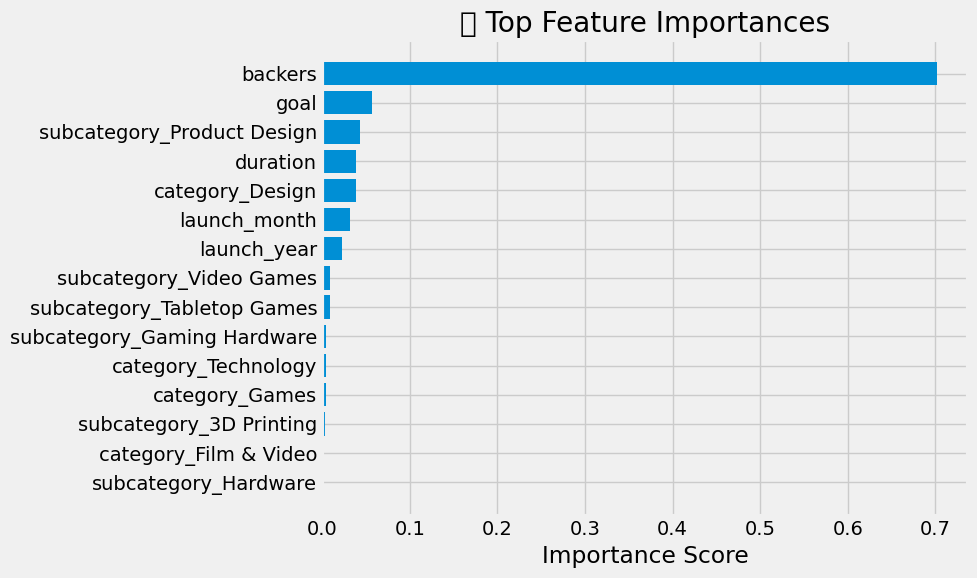

In [232]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Evaluation metrics
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print(f"📊 Model Evaluation:")
print(f"  MAE  = {mae:,.2f}")
print(f"  RMSE = {rmse:,.2f}")
print(f"  R²   = {r2:.3f}")

# Feature names from preprocessor
cat_cols = pipeline.named_steps['preprocessor'].named_transformers_['cat'].get_feature_names_out(categorical_features)
all_feature_names = list(cat_cols) + numeric_features

# Feature importances
importances = pipeline.named_steps['regressor'].feature_importances_
indices = np.argsort(importances)[-15:]  # Top 15

# Plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(indices)), importances[indices], align='center')
plt.yticks(range(len(indices)), [all_feature_names[i] for i in indices])
plt.title("🔍 Top Feature Importances")
plt.xlabel("Importance Score")
plt.tight_layout()
plt.show()

In [10]:
# Calculate overall averages
overall_avg_backers = df_clean['backers'].mean()
overall_avg_pledge_per_backer = (df_clean['pledged'] / df_clean['backers']).replace([np.inf, -np.inf], np.nan).dropna().mean()

# Grouped averages
grouped_stats = df_clean.groupby(['country', 'category', 'subcategory']).agg(
    avg_backers=('backers', 'mean'),
    avg_pledge_per_backer=('ave_backer', lambda x: x.replace([np.inf, -np.inf], np.nan).dropna().mean()),
    num_projects=('id', 'count')
).reset_index()

# Sort by number of projects (optional)
grouped_stats = grouped_stats.sort_values(by='num_projects', ascending=False)

# Display overall stats and grouped stats
print(grouped_stats)  # or
grouped_stats.head()  # or
from IPython.display import display
display(grouped_stats)

overall_avg_backers, overall_avg_pledge_per_backer

            country      category     subcategory  avg_backers   
2648  United States        Design  Product Design   351.398267  \
2662  United States  Film & Video     Documentary   101.711104   
2719  United States         Music           Music    72.158642   
2675  United States  Film & Video          Shorts    40.145300   
2698  United States         Games  Tabletop Games   555.837118   
...             ...           ...             ...          ...   
2389    Switzerland         Music           Blues    46.000000   
2388    Switzerland    Journalism             Web     1.000000   
2387    Switzerland    Journalism           Video     5.000000   
1358     Luxembourg          Food     Restaurants    62.000000   
2229         Sweden  Film & Video  Narrative Film     1.000000   

      avg_pledge_per_backer  num_projects  
2648              94.752751         13732  
2662              87.358768         12347  
2719              63.049103         10924  
2675              80.495800    

,country,category,subcategory,avg_backers,avg_pledge_per_backer,num_projects
2648,United States,Design,Product Design,351.398267,94.752751,13732
2662,United States,Film & Video,Documentary,101.711104,87.358768,12347
2719,United States,Music,Music,72.158642,63.049103,10924
2675,United States,Film & Video,Shorts,40.145300,80.495800,9532
2698,United States,Games,Tabletop Games,555.837118,57.756739,8939
...,...,...,...,...,...,...
2389,Switzerland,Music,Blues,46.000000,90.500000,1
2388,Switzerland,Journalism,Web,1.000000,10.000000,1
2387,Switzerland,Journalism,Video,5.000000,65.400000,1
1358,Luxembourg,Food,Restaurants,62.000000,142.258065,1


(116.4851705656551, 74.85739306167113)

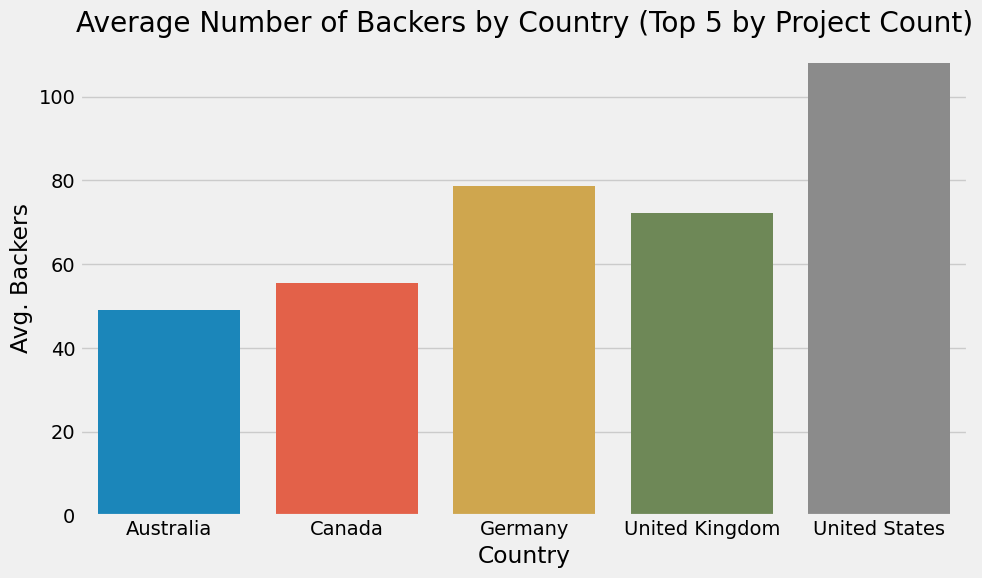

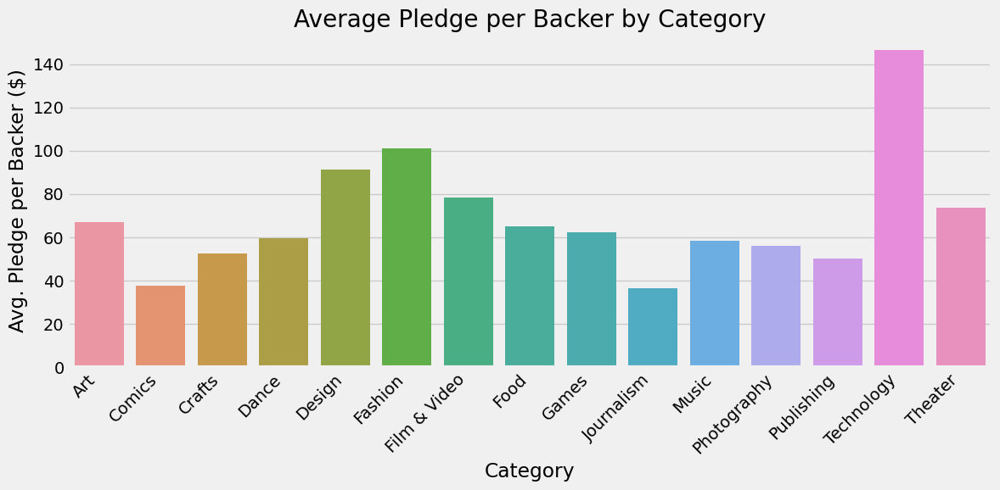

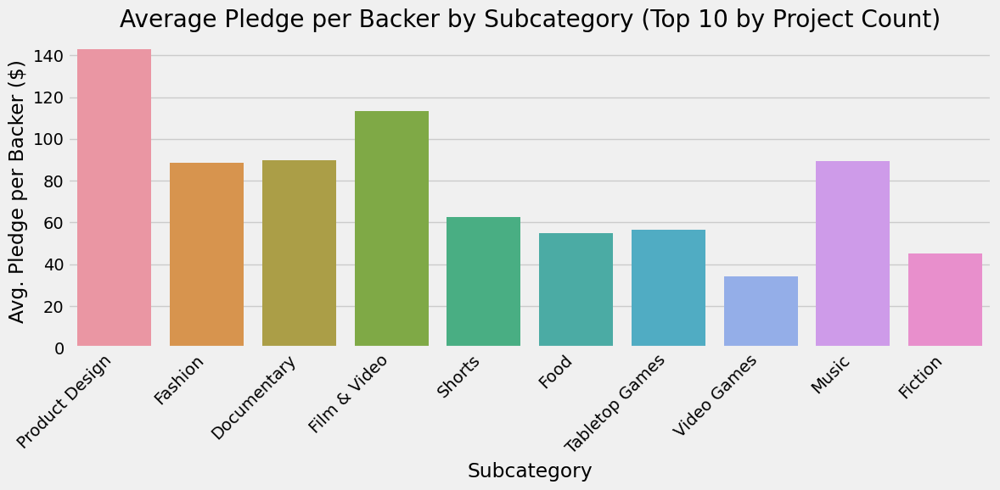

(116.4851705656551, 74.85739306167113)

In [11]:
# Convert dates
df['launched'] = pd.to_datetime(df['launched'], errors='coerce')
df['deadline'] = pd.to_datetime(df['deadline'], errors='coerce')

# Add average pledge per backer
df['ave_backer'] = df['pledged'] / df['backers']
df['ave_backer'].replace([np.inf, -np.inf], np.nan, inplace=True)

# Overall averages
overall_avg_backers = df['backers'].mean()
overall_avg_pledge_per_backer = df['ave_backer'].dropna().mean()

# Grouped stats
grouped_stats = df.groupby(['country', 'category', 'subcategory']).agg(
    avg_backers=('backers', 'mean'),
    avg_pledge_per_backer=('ave_backer', 'mean'),
    num_projects=('id', 'count')
).reset_index()

# Show top countries by number of projects
top_countries = grouped_stats.groupby('country')['num_projects'].sum().sort_values(ascending=False).head(5).index

# Plot 1: Average number of backers by country (top 5)
plt.figure(figsize=(10, 6))
sns.barplot(data=grouped_stats[grouped_stats['country'].isin(top_countries)],
            x='country', y='avg_backers', estimator=np.mean, ci=None)
plt.title('Average Number of Backers by Country (Top 5 by Project Count)')
plt.ylabel('Avg. Backers')
plt.xlabel('Country')
plt.tight_layout()
plt.show()

# Plot 2: Average pledge per backer by category
plt.figure(figsize=(12, 6))
sns.barplot(data=grouped_stats, x='category', y='avg_pledge_per_backer', estimator=np.mean, ci=None)
plt.xticks(rotation=45, ha='right')
plt.title('Average Pledge per Backer by Category')
plt.ylabel('Avg. Pledge per Backer ($)')
plt.xlabel('Category')
plt.tight_layout()
plt.show()

# Plot 3: Average pledge per backer by subcategory (top 10)
top_subs = grouped_stats.groupby('subcategory')['num_projects'].sum().sort_values(ascending=False).head(10).index

plt.figure(figsize=(12, 6))
sns.barplot(data=grouped_stats[grouped_stats['subcategory'].isin(top_subs)],
            x='subcategory', y='avg_pledge_per_backer', estimator=np.mean, ci=None)
plt.xticks(rotation=45, ha='right')
plt.title('Average Pledge per Backer by Subcategory (Top 10 by Project Count)')
plt.ylabel('Avg. Pledge per Backer ($)')
plt.xlabel('Subcategory')
plt.tight_layout()
plt.show()

# Return the key numeric results
overall_avg_backers, overall_avg_pledge_per_backer

In [62]:
df.head(5)

,id,name,category,subcategory,country,launched,deadline,goal,pledged,backers,state,duration,launch_month,launch_year
0,1860890148,Grace Jones Does Not Give A F$#% T-Shirt (limi...,Fashion,Fashion,United States,2009-04-21 21:02:48,2009-05-31,1000,625,30,Failed,39,4,2009
1,709707365,CRYSTAL ANTLERS UNTITLED MOVIE,Film & Video,Shorts,United States,2009-04-23 00:07:53,2009-07-20,80000,22,3,Failed,87,4,2009
2,1703704063,drawing for dollars,Art,Illustration,United States,2009-04-24 21:52:03,2009-05-03,20,35,3,Successful,8,4,2009
3,727286,Offline Wikipedia iPhone app,Technology,Software,United States,2009-04-25 17:36:21,2009-07-14,99,145,25,Successful,79,4,2009
4,1622952265,Pantshirts,Fashion,Fashion,United States,2009-04-27 14:10:39,2009-05-26,1900,387,10,Failed,28,4,2009


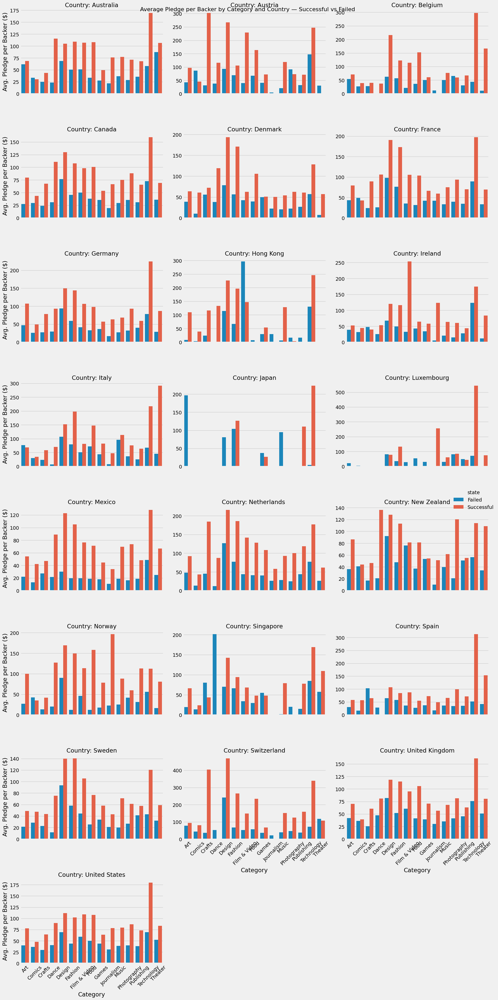

In [66]:
# Focus again on successful and failed projects
df_filtered = df_clean[df_clean['state'].isin(['Successful', 'Failed'])].copy()

# Group by state, country, and category (subcategory optional for readability)
grouped_detailed = df_filtered.groupby(['state', 'country', 'category']).agg(
    avg_backers=('backers', 'mean'),
    avg_pledge_per_backer=('ave_backer', 'mean'),
    num_projects=('id', 'count')
).reset_index()

# Filter top 5 countries by project count
top_countries = grouped_detailed.groupby('country')['num_projects'].sum().sort_values(ascending=False).head(22).index
df_top = grouped_detailed[grouped_detailed['country'].isin(top_countries)]

# Plot: Avg pledge per backer by category within each top country, differentiated by project state
g = sns.catplot(
    data=df_top,
    kind='bar',
    x='category',
    y='avg_pledge_per_backer',
    hue='state',
    col='country',
    col_wrap=3,
    sharey=False,
    height=5,
    aspect=1.2,
    ci=None
)
g.set_titles("Country: {col_name}")
g.set_axis_labels("Category", "Avg. Pledge per Backer ($)")
for ax in g.axes.flatten():
    ax.tick_params(axis='x', rotation=45)
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Average Pledge per Backer by Category and Country — Successful vs Failed", fontsize=16)
plt.tight_layout()
plt.show()

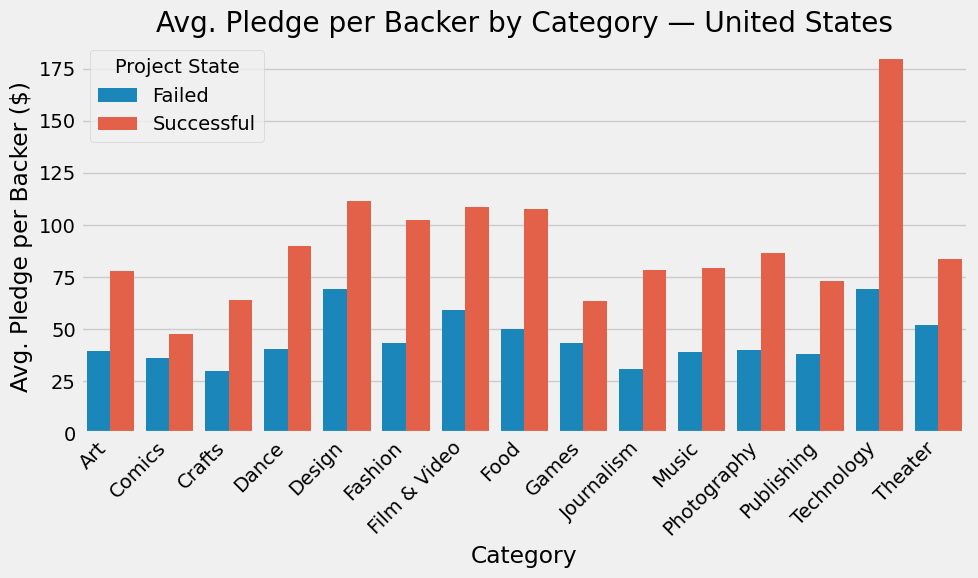

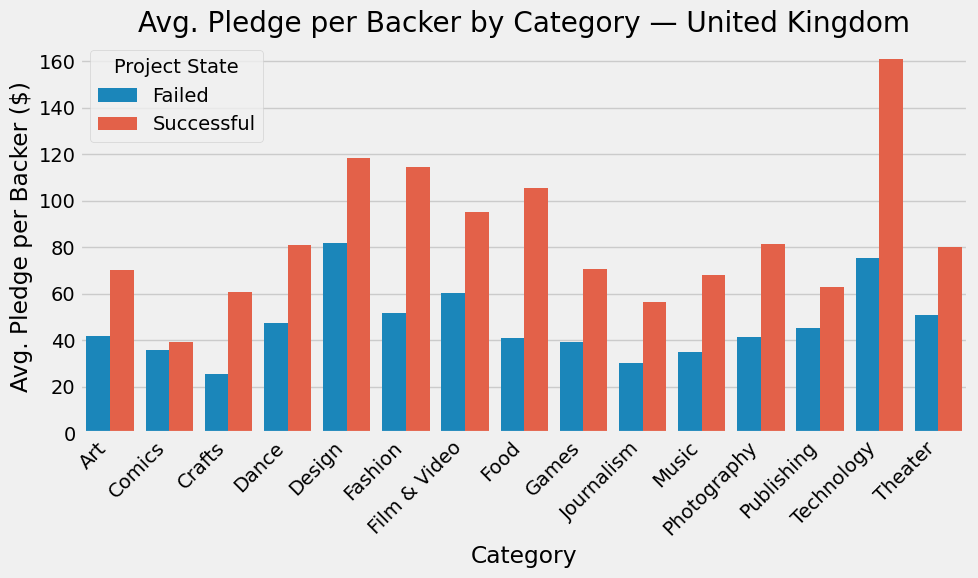

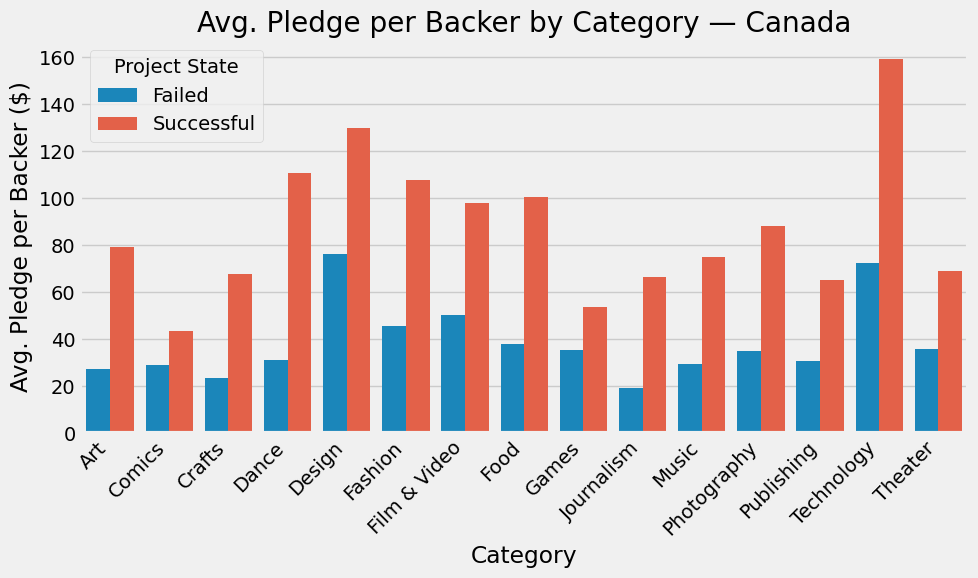

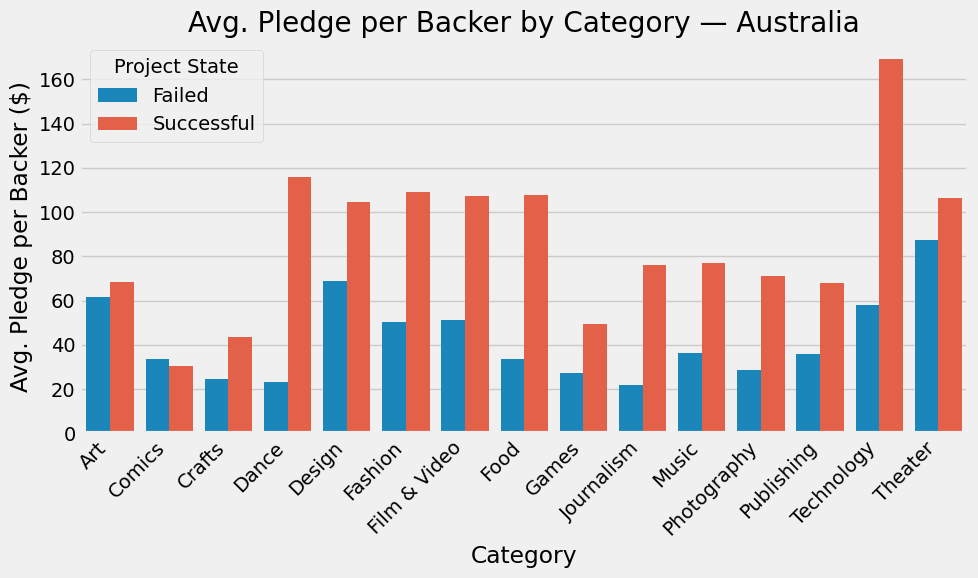

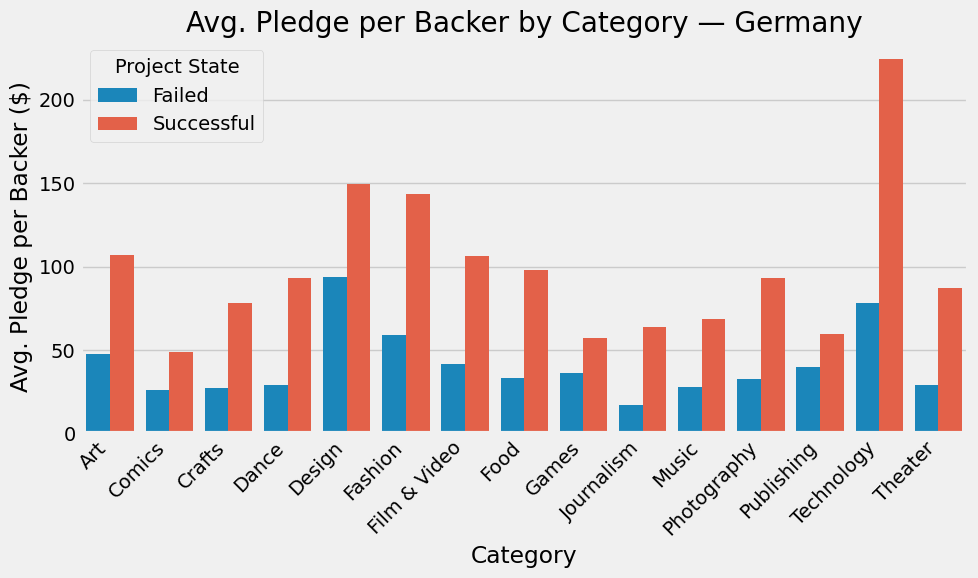

...

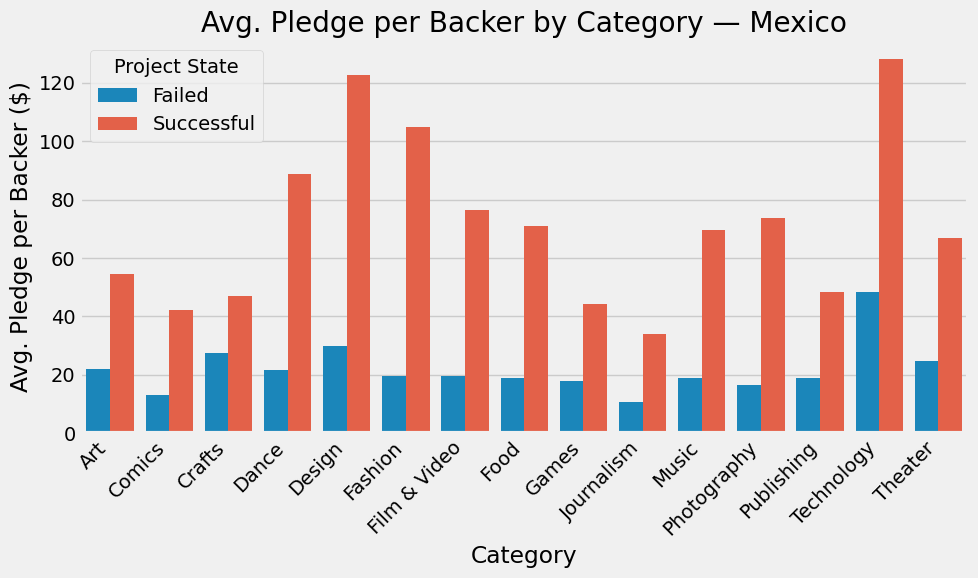

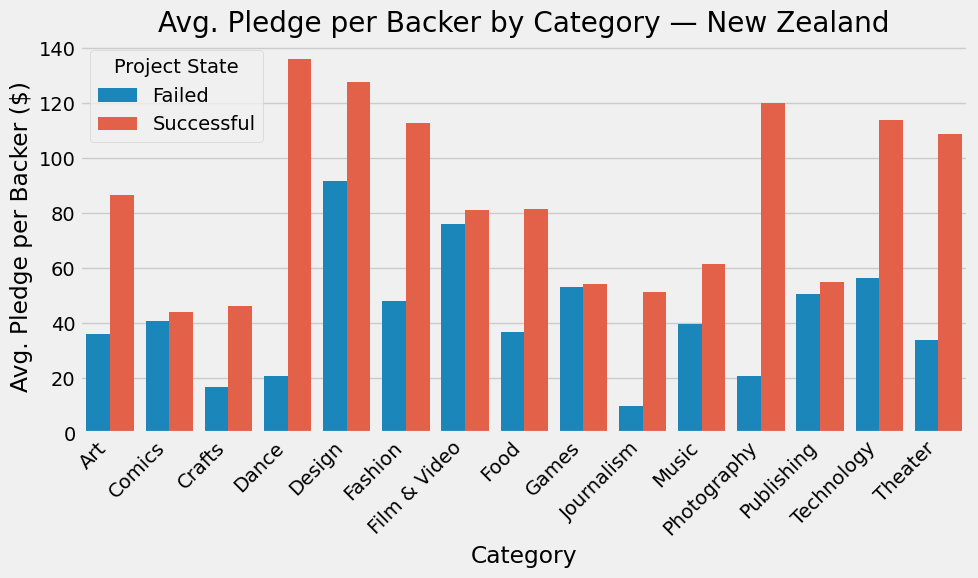

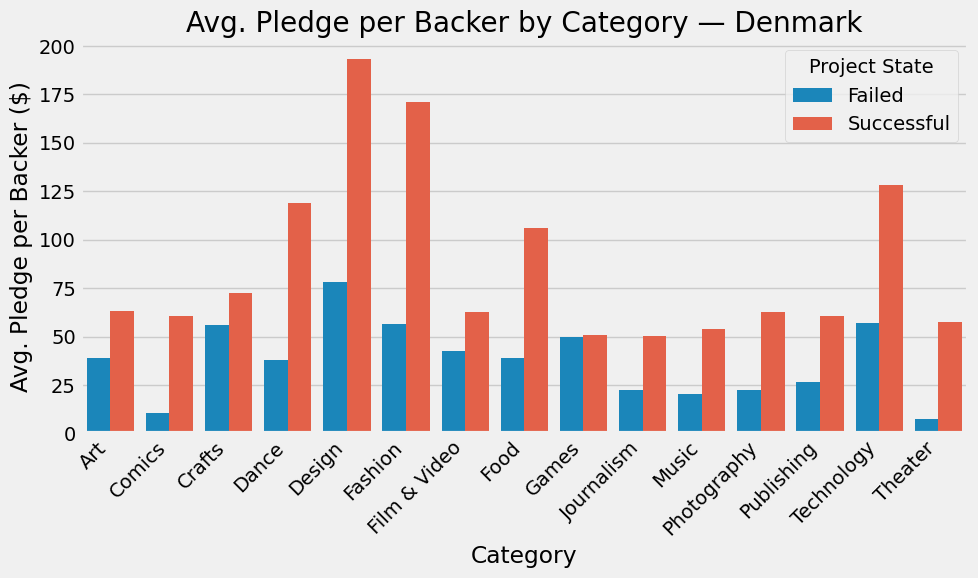

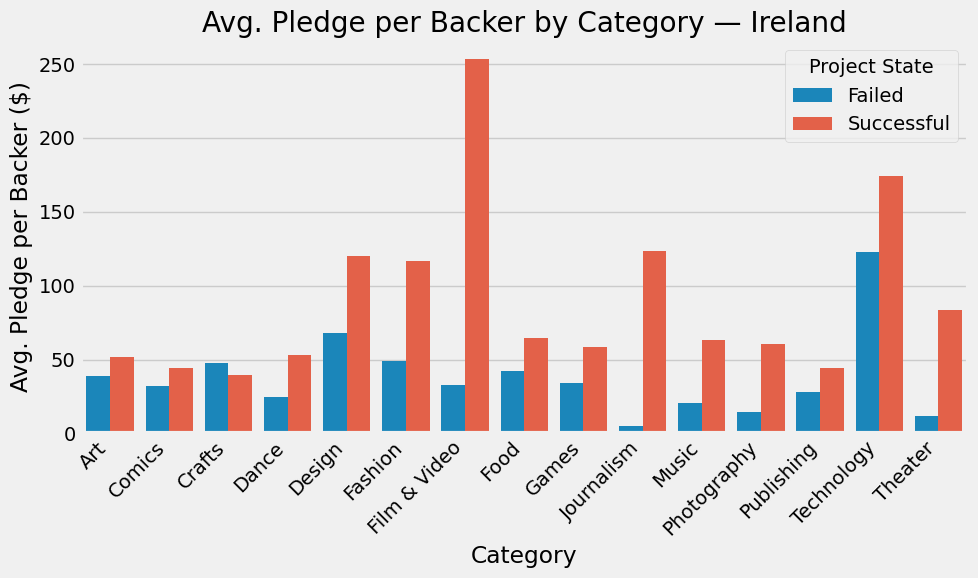

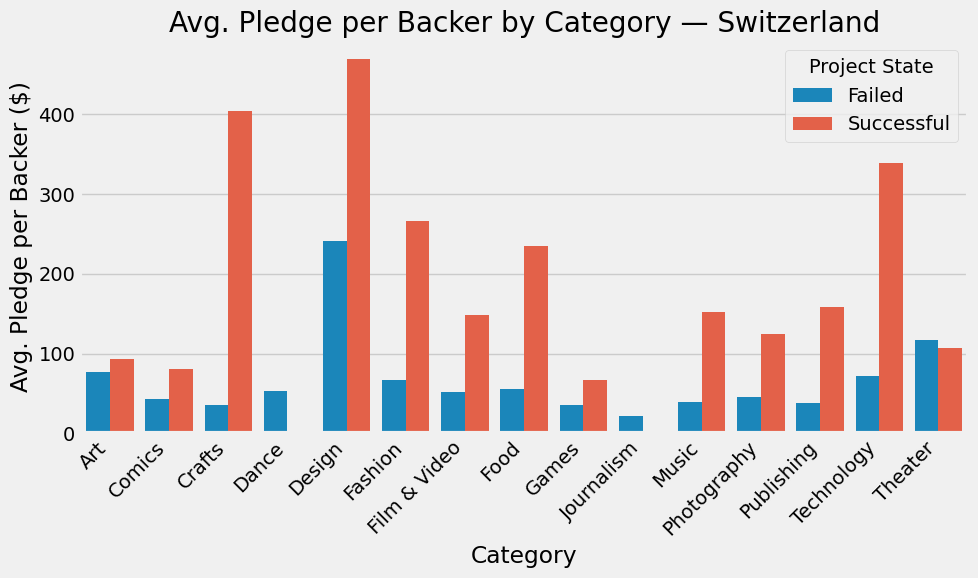

In [70]:
# Reduce the dataset for successful and failed projects
df_filtered = df_clean[df_clean['state'].isin(['Successful', 'Failed'])].copy()

# Group by state, country, and category
grouped_detailed = df_filtered.groupby(['state', 'country', 'category']).agg(
    avg_backers=('backers', 'mean'),
    avg_pledge_per_backer=('ave_backer', 'mean'),
    num_projects=('id', 'count')
).reset_index()

# Top countries (e.g., top 15 to keep output manageable)
top_countries = grouped_detailed.groupby('country')['num_projects'].sum().sort_values(ascending=False).head(15).index
grouped_detailed_top = grouped_detailed[grouped_detailed['country'].isin(top_countries)]

# Create a plot for each country individually
for country in top_countries:
    data_country = grouped_detailed_top[grouped_detailed_top['country'] == country]

    plt.figure(figsize=(10, 6))
    sns.barplot(data=data_country, x='category', y='avg_pledge_per_backer', hue='state', ci=None)
    plt.title(f"Avg. Pledge per Backer by Category — {country}")
    plt.ylabel("Avg. Pledge per Backer ($)")
    plt.xlabel("Category")
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Project State')
    plt.tight_layout()
    plt.show()

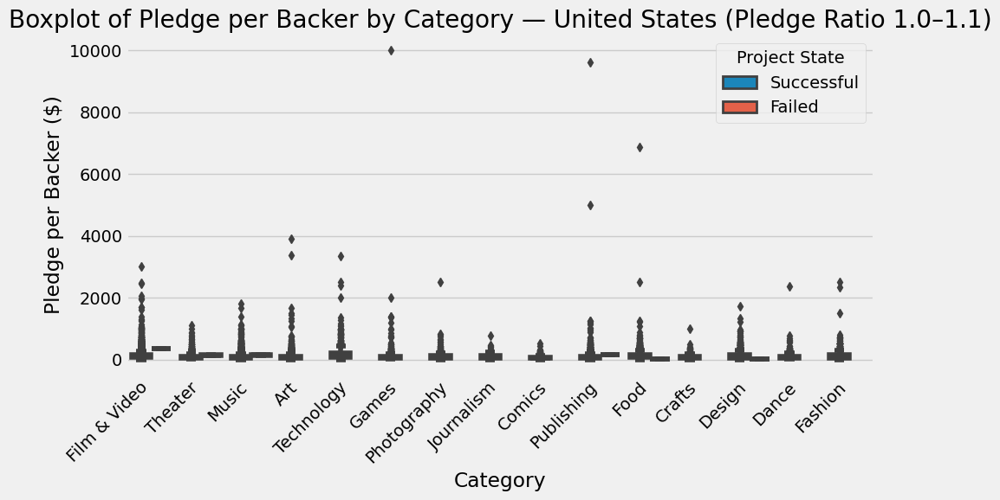

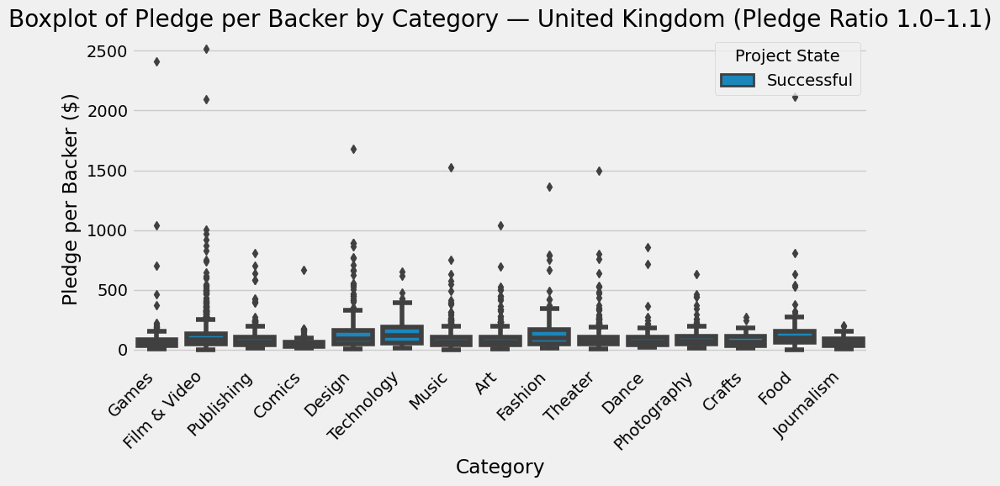

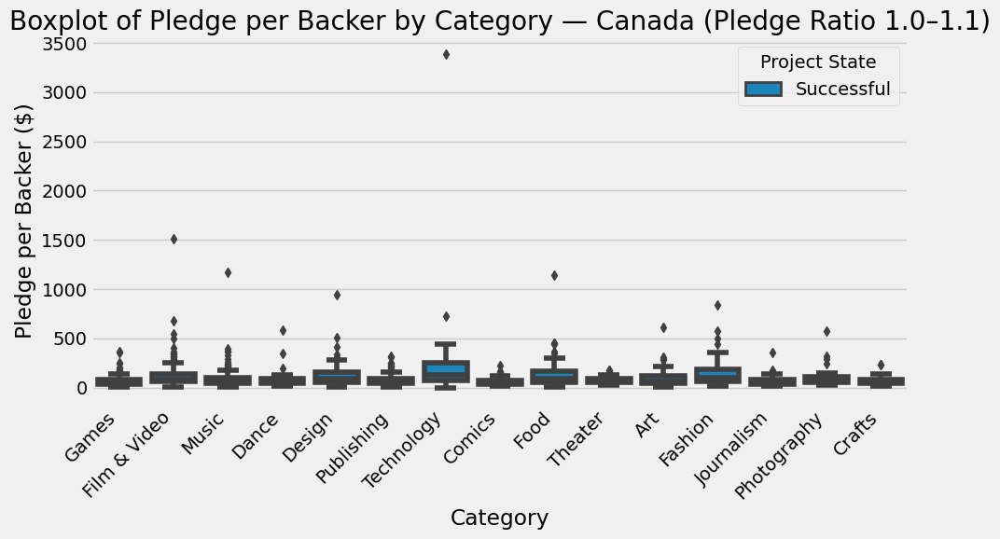

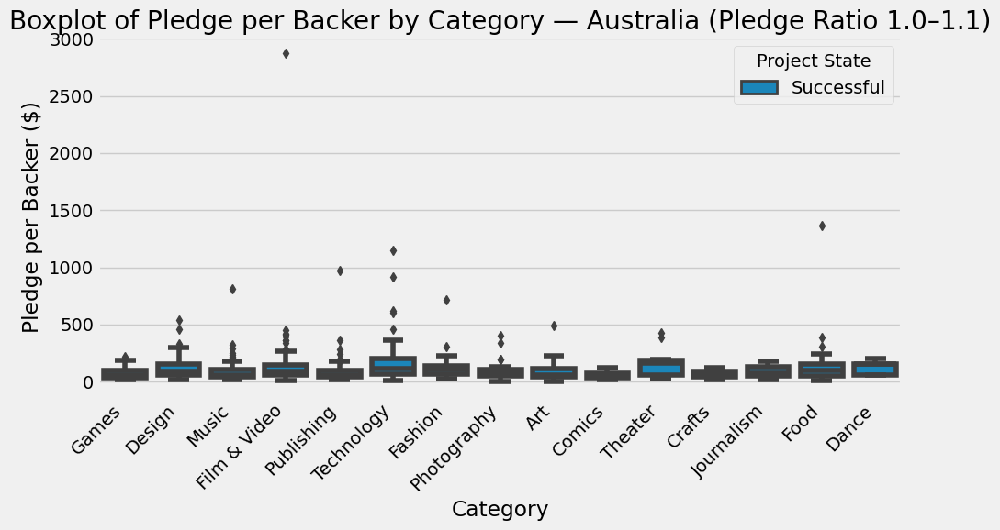

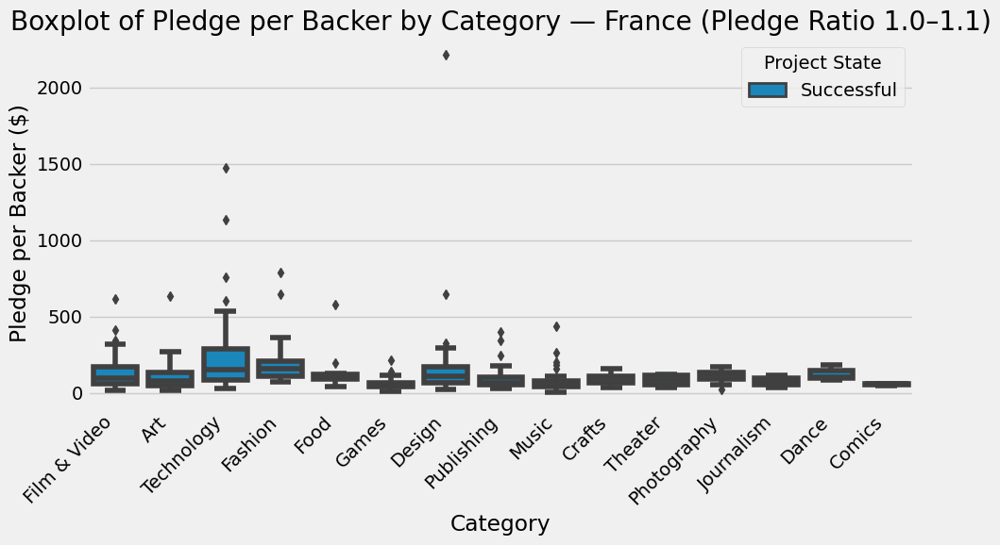

...

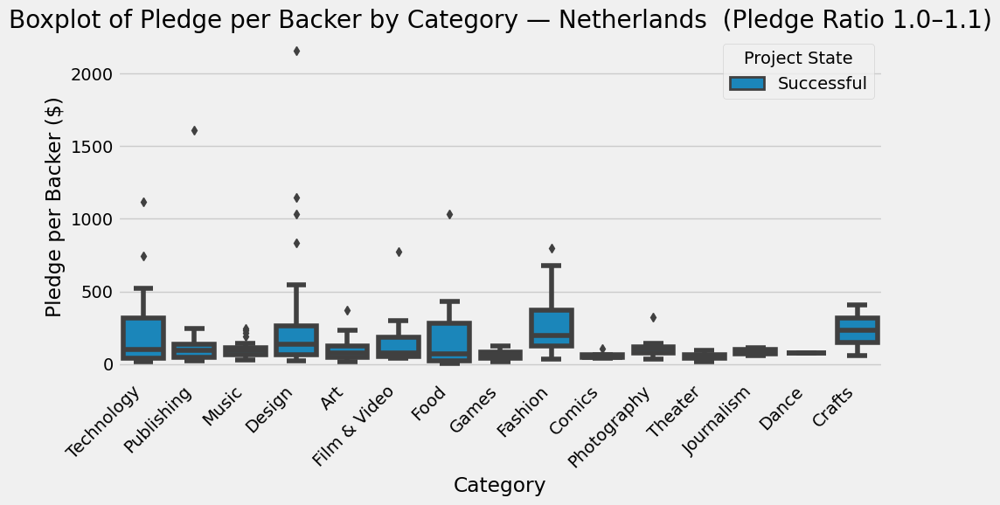

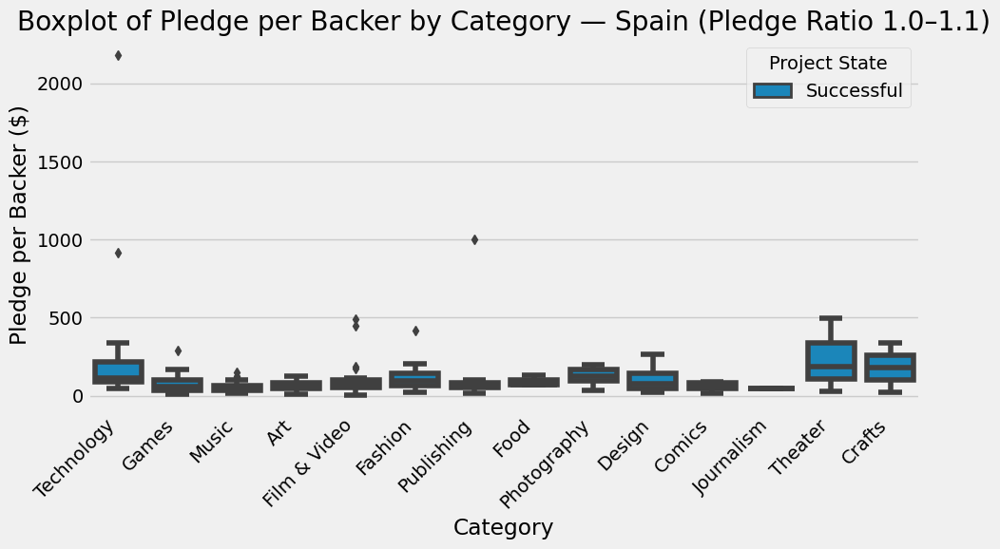

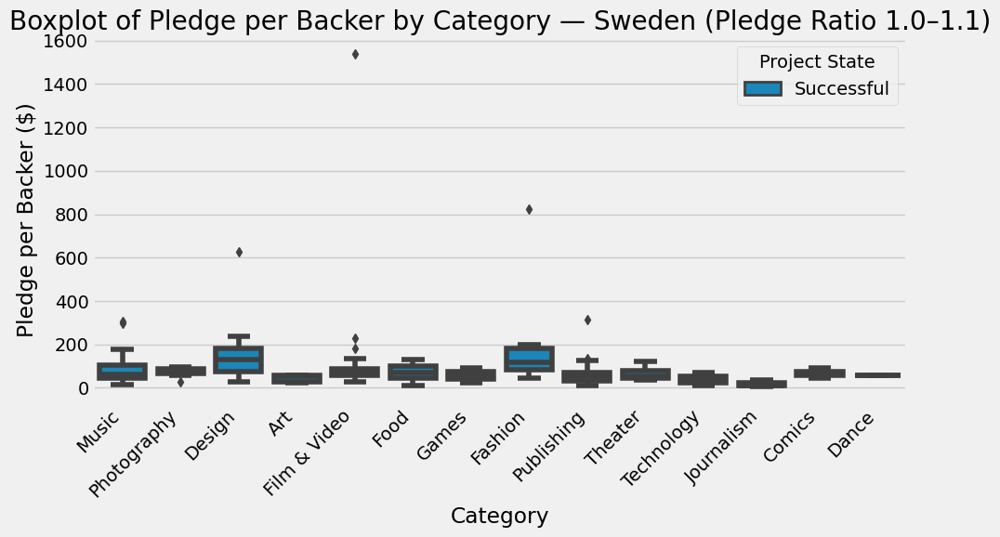

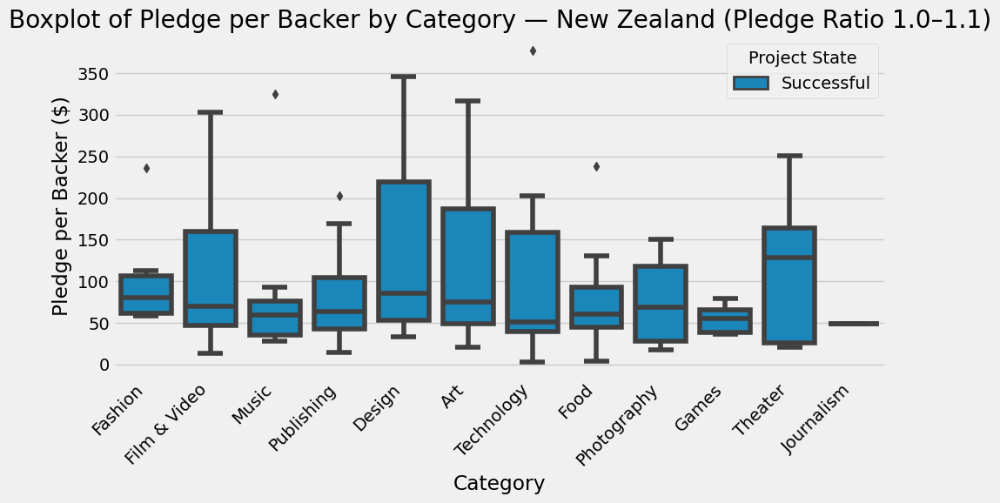

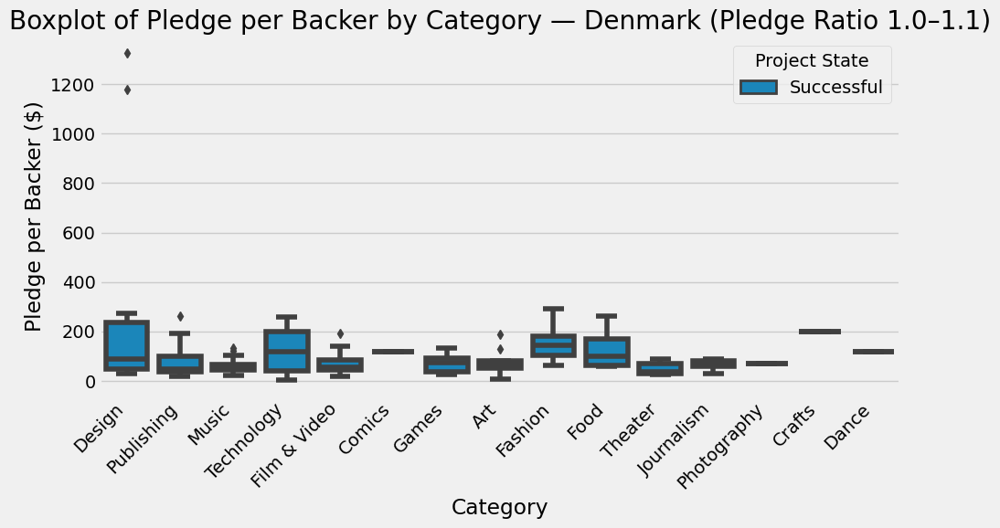

In [72]:
# Filter the data for pledge_ratio between 1.0 and 1.1 and valid states
df_clean['pledge_ratio'] = df_clean['pledged'] / df_clean['goal']
df_filtered_ratio = df_clean[
    (df_clean['state'].isin(['Successful', 'Failed'])) &
    (df_clean['pledge_ratio'] >= 1.0) &
    (df_clean['pledge_ratio'] <= 1.1)
].copy()

# Add average pledge per backer again just in case
df_filtered_ratio['ave_backer'] = df_filtered_ratio['pledged'] / df_filtered_ratio['backers']
df_filtered_ratio['ave_backer'].replace([np.inf, -np.inf], np.nan, inplace=True)

# Select top countries based on project count within this filtered group
top_countries = df_filtered_ratio['country'].value_counts().head(12).index

# Plot boxplots for each top country
for country in top_countries:
    df_country = df_filtered_ratio[df_filtered_ratio['country'] == country]

    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df_country, x='category', y='ave_backer', hue='state')
    plt.title(f"Boxplot of Pledge per Backer by Category — {country} (Pledge Ratio 1.0–1.1)")
    plt.ylabel("Pledge per Backer ($)")
    plt.xlabel("Category")
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Project State')
    plt.tight_layout()
    plt.show()

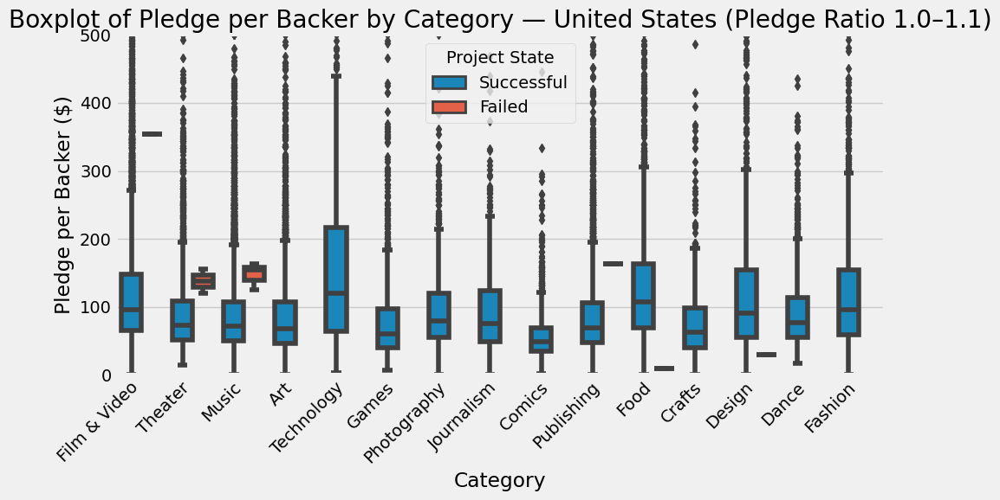

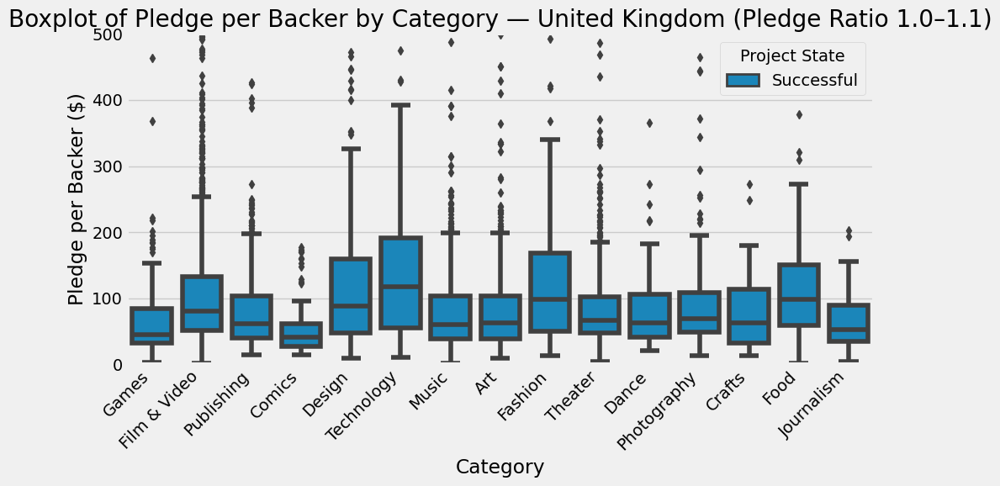

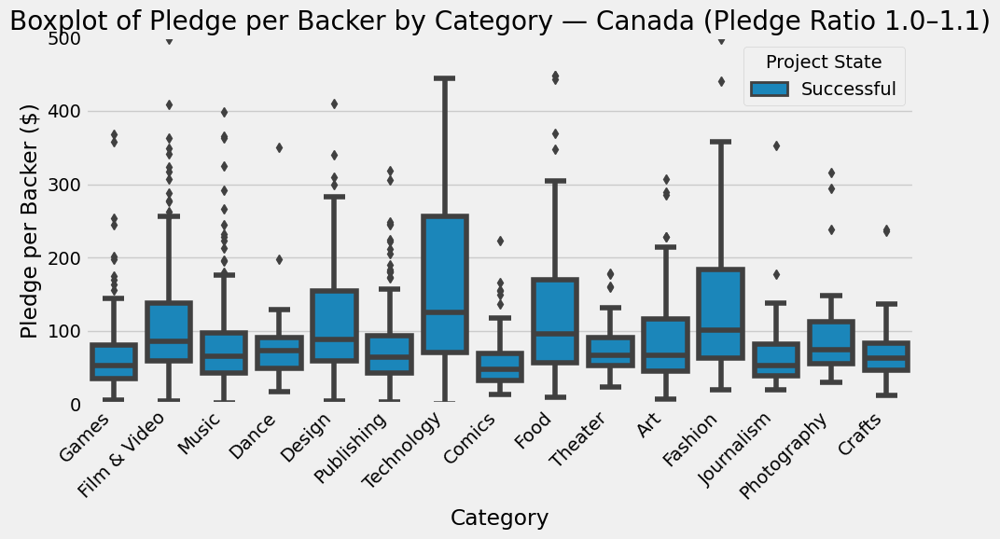

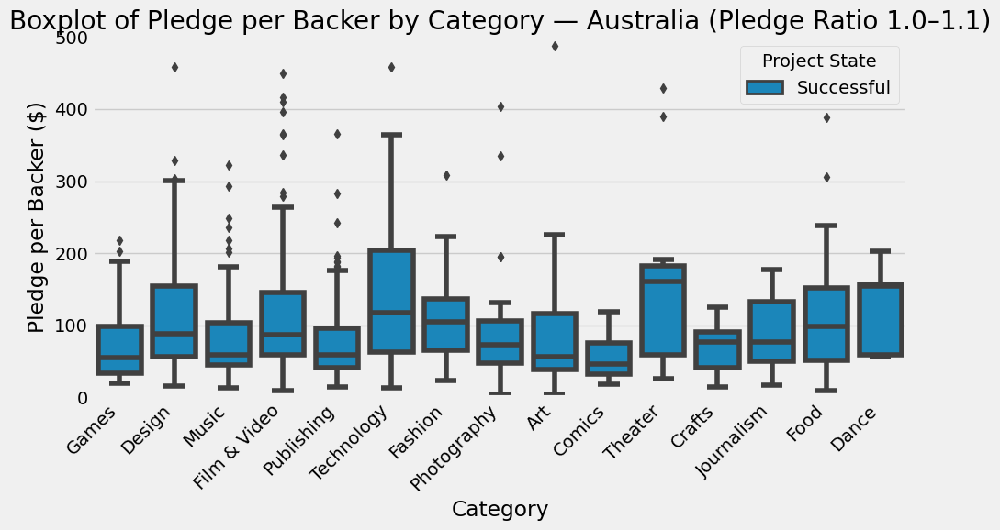

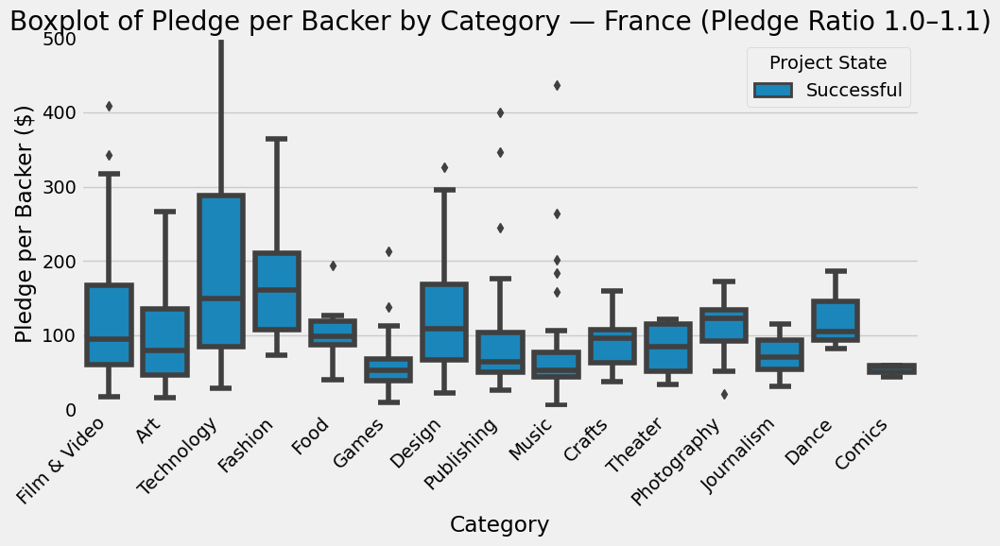

...

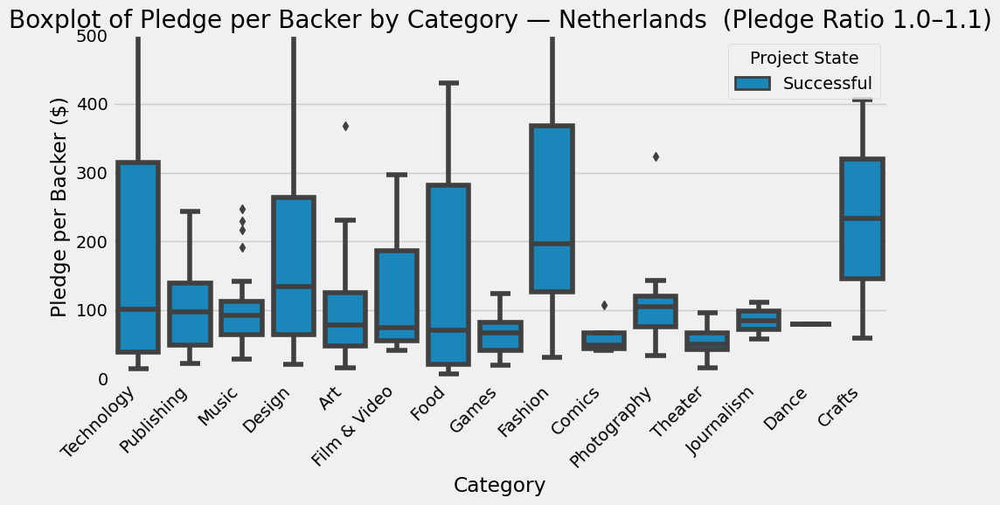

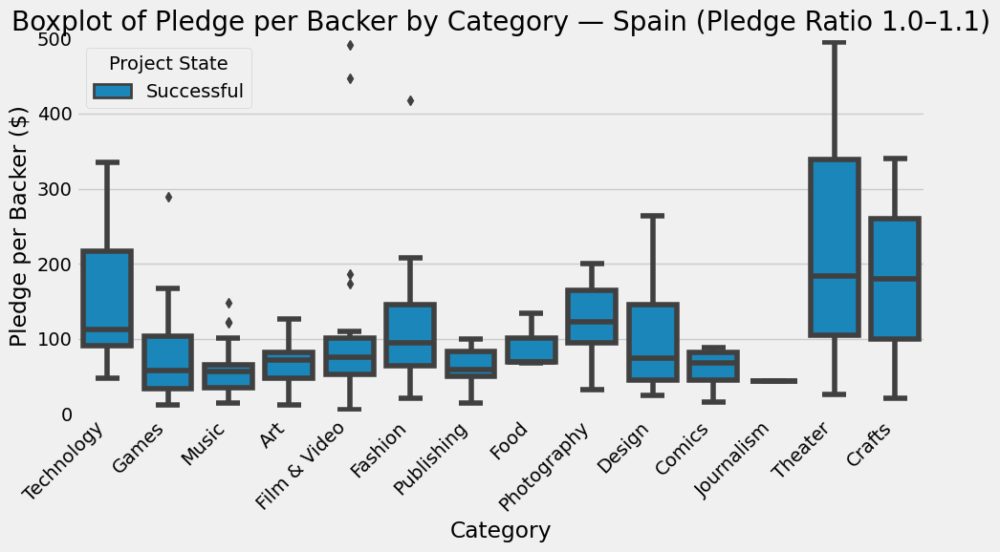

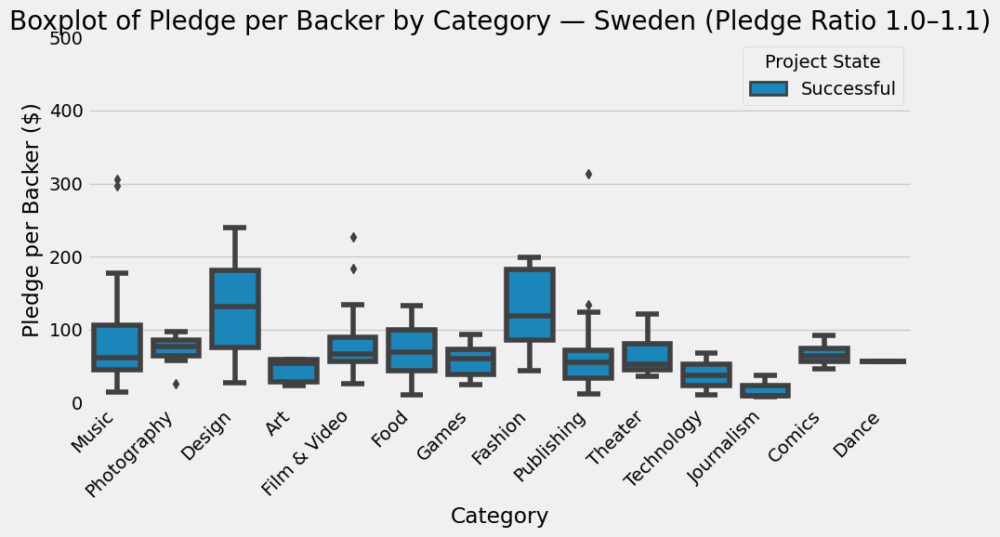

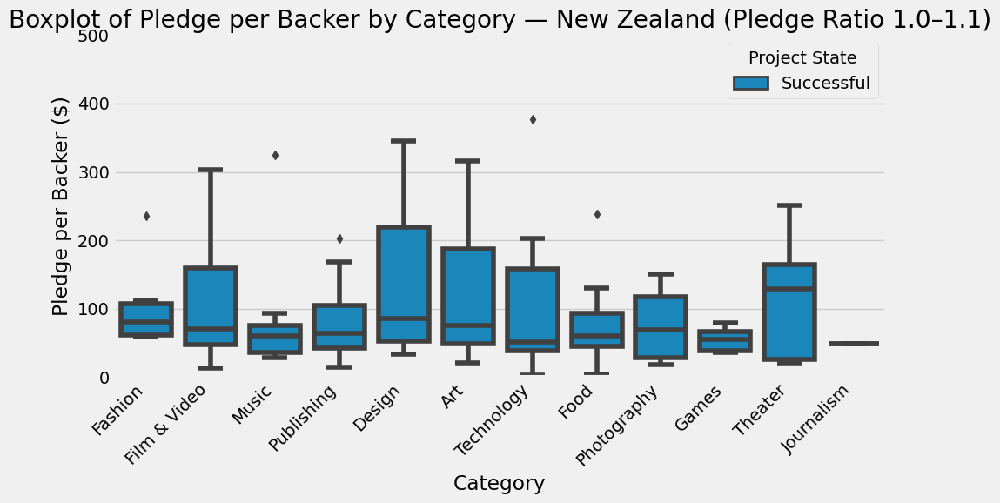

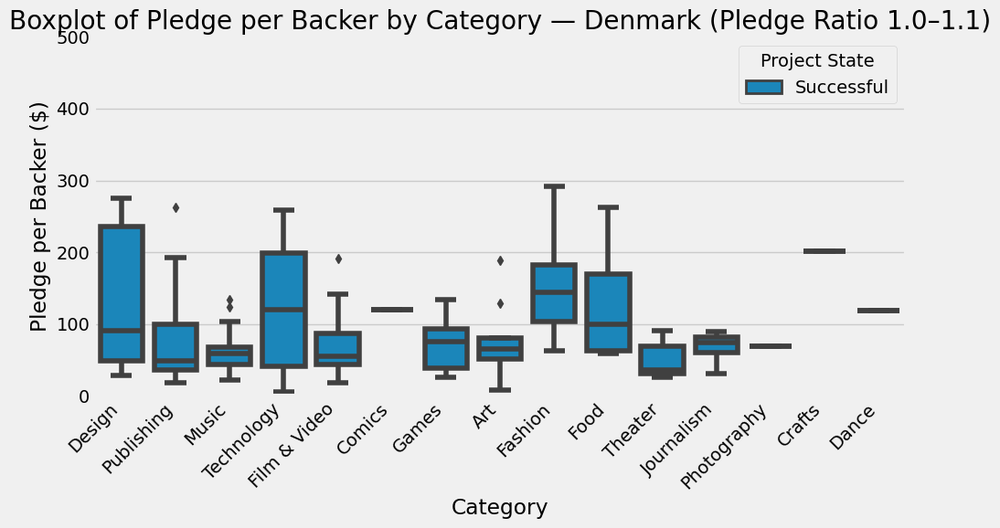

In [79]:
# Same plots as before, but limit the y-axis to 500
for country in top_countries:
    df_country = df_filtered_ratio[df_filtered_ratio['country'] == country]

    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df_country, x='category', y='ave_backer', hue='state')
    plt.title(f"Boxplot of Pledge per Backer by Category — {country} (Pledge Ratio 1.0–1.1)")
    plt.ylabel("Pledge per Backer ($)")
    plt.xlabel("Category")
    plt.ylim(0, 500)  # Limit y-axis
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Project State')
    plt.tight_layout()
    plt.show()

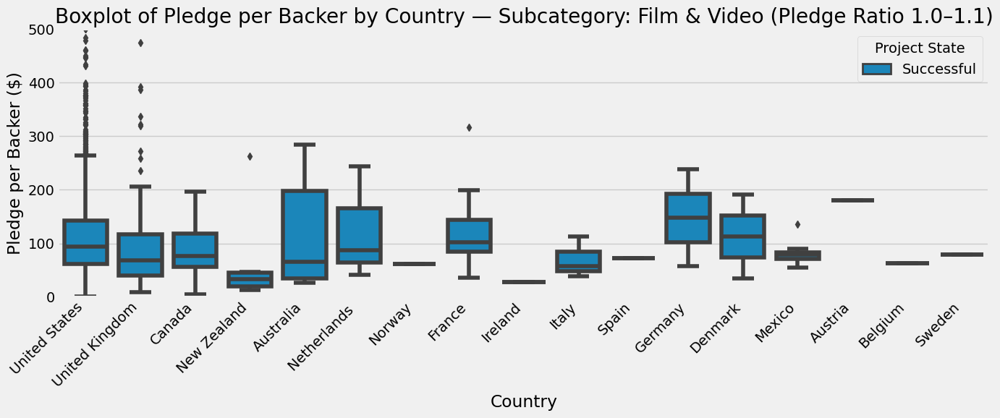

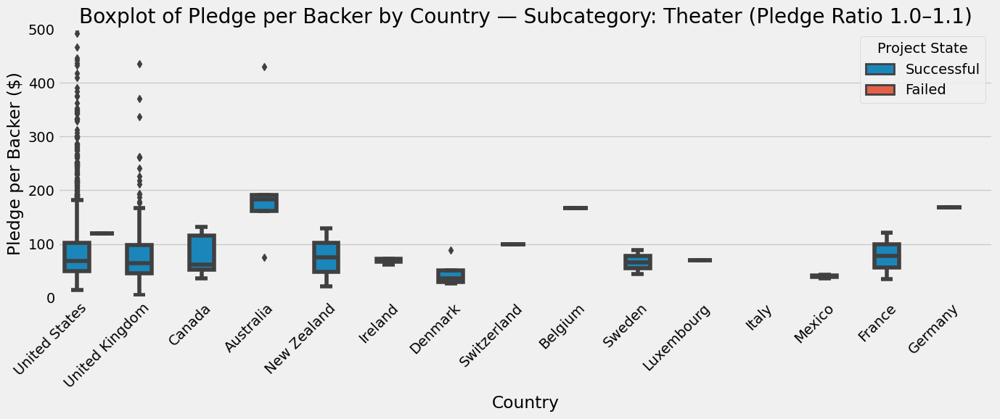

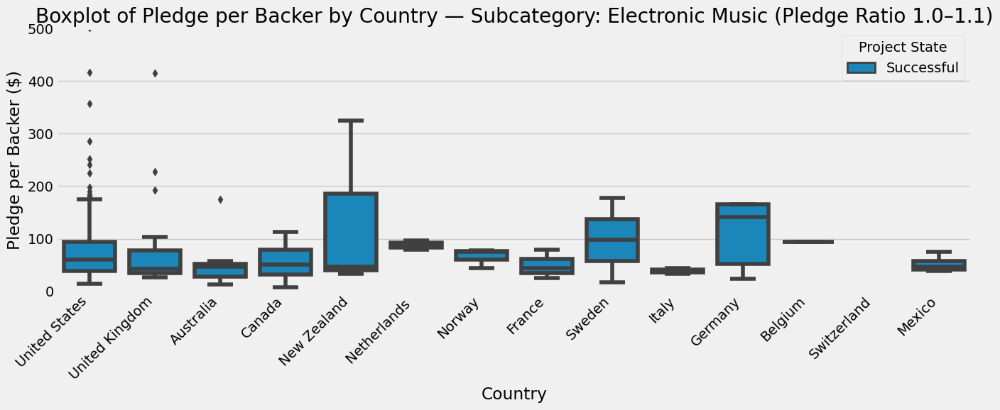

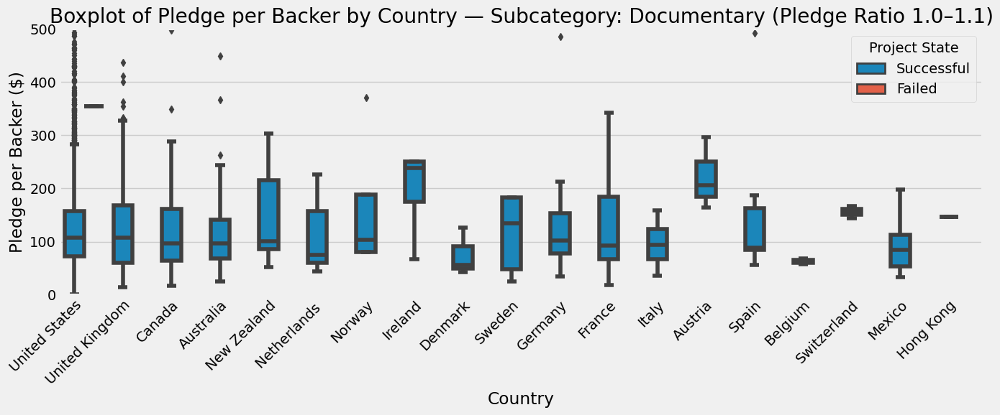

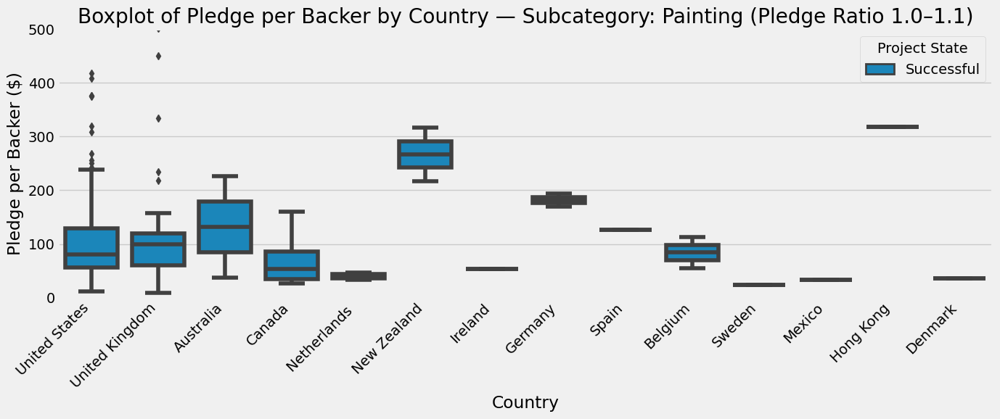

...

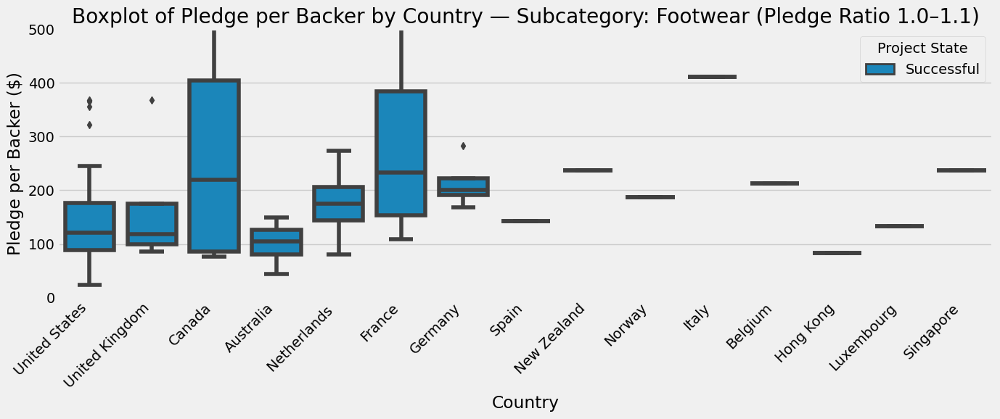

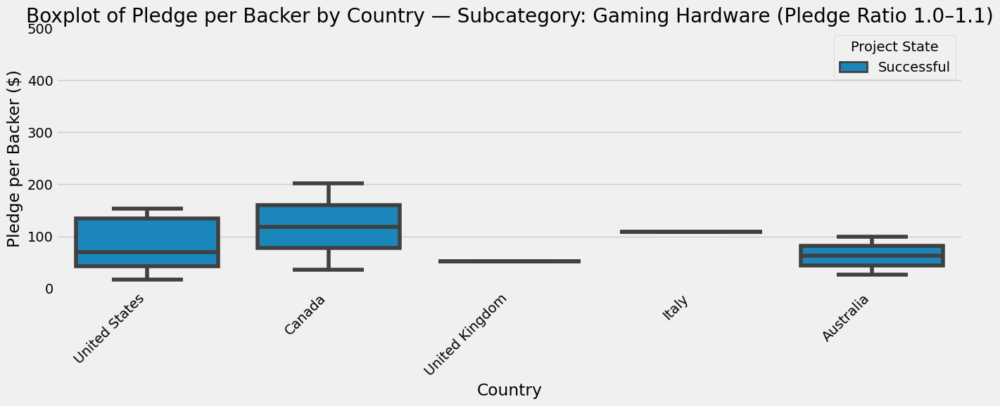

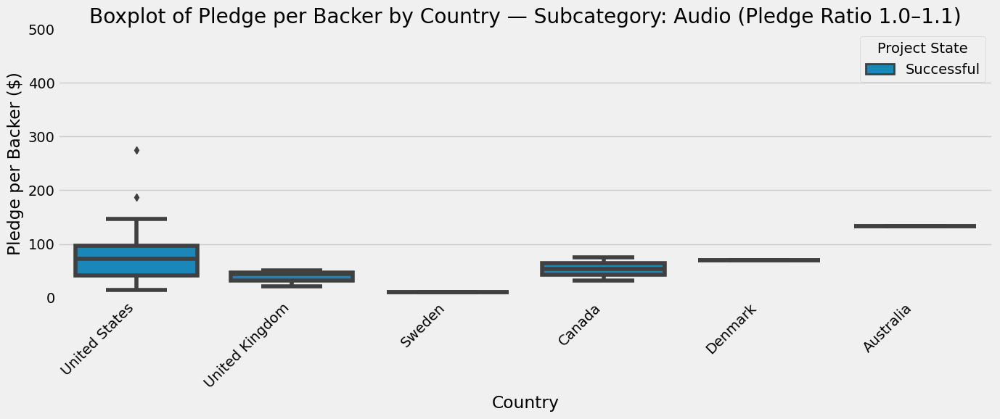

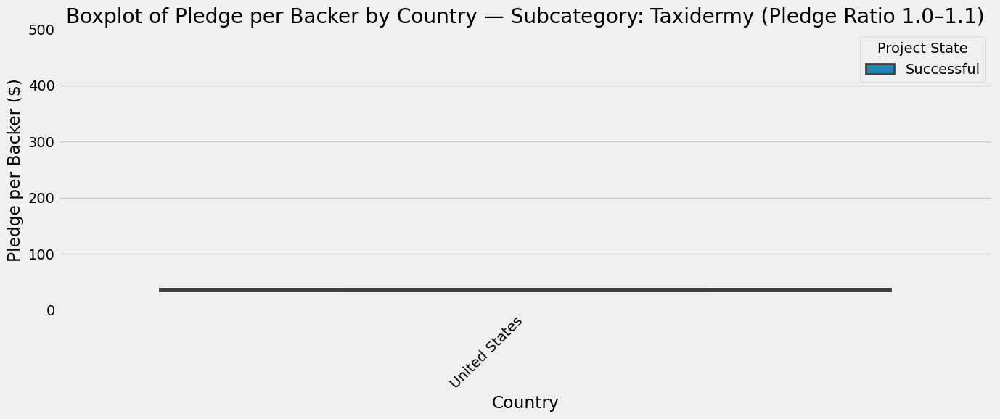

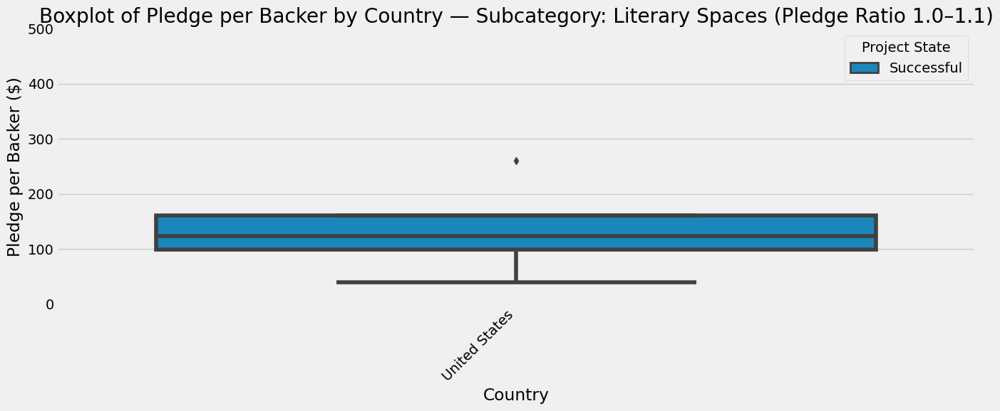

In [80]:
# Get top 22 countries by project count in the filtered ratio range
top_countries = df_filtered_ratio['country'].value_counts().head(22).index

# Get all unique subcategories
subcategories = df_filtered_ratio['subcategory'].unique()

# Plot for each subcategory, showing all 22 countries
for subcat in subcategories:
    df_subcat = df_filtered_ratio[df_filtered_ratio['subcategory'] == subcat]
    df_subcat = df_subcat[df_subcat['country'].isin(top_countries)]

    if df_subcat.empty:
        continue  # skip if no data

    plt.figure(figsize=(14, 6))
    sns.boxplot(data=df_subcat, x='country', y='ave_backer', hue='state')
    plt.title(f"Boxplot of Pledge per Backer by Country — Subcategory: {subcat} (Pledge Ratio 1.0–1.1)")
    plt.ylabel("Pledge per Backer ($)")
    plt.xlabel("Country")
    plt.ylim(0, 500)  # Limit y-axis
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Project State')
    plt.tight_layout()
    plt.show()

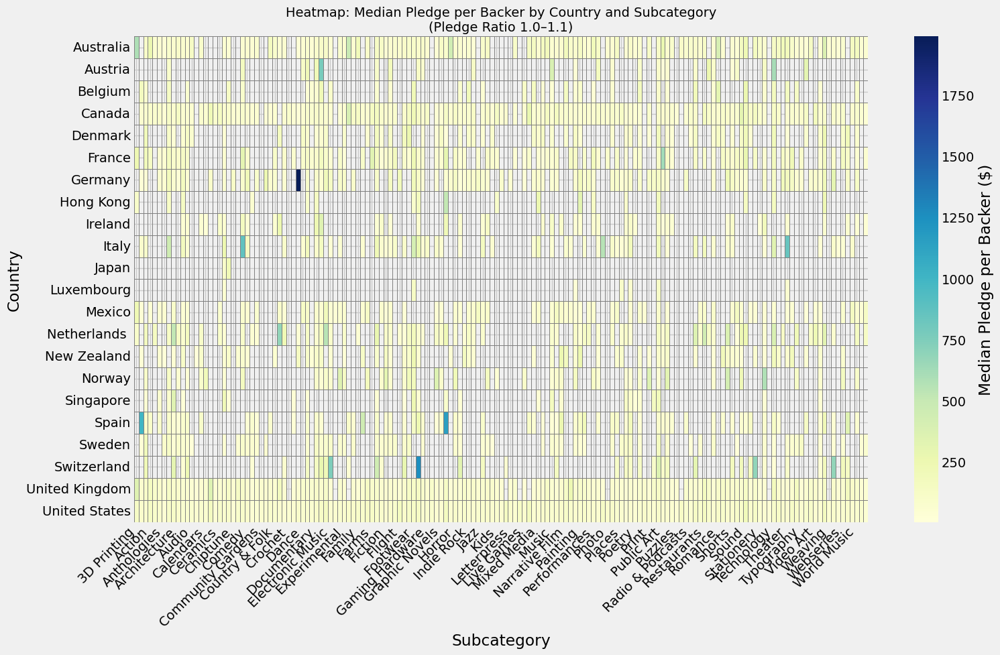

In [84]:
# Re-import required libraries after session reset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Reload the dataset
df_clean =pd.read_csv("../data/kickstarter_common.csv")

# Recompute necessary fields
df_clean['pledge_ratio'] = df_clean['pledged'] / df_clean['goal']
df_clean['ave_backer'] = df_clean['pledged'] / df_clean['backers']
df_clean['ave_backer'].replace([np.inf, -np.inf], np.nan, inplace=True)

# Filter for pledge_ratio between 1.0 and 1.1
df_heatmap = df_clean[
    (df_clean['pledge_ratio'] >= 1.0) &
    (df_clean['pledge_ratio'] <= 1.1)
].copy()

# Pivot table: country vs subcategory with median(ave_backer)
heatmap_data = df_heatmap.pivot_table(
    index='country',
    columns='subcategory',
    values='ave_backer',
    aggfunc='median'
)

# Plot the heatmap
plt.figure(figsize=(16, 10))
sns.heatmap(heatmap_data, cmap='YlGnBu', linewidths=0.5, linecolor='gray', annot=False, cbar_kws={'label': 'Median Pledge per Backer ($)'})
plt.title("Heatmap: Median Pledge per Backer by Country and Subcategory\n(Pledge Ratio 1.0–1.1)", fontsize=14)
plt.xlabel("Subcategory")
plt.ylabel("Country")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

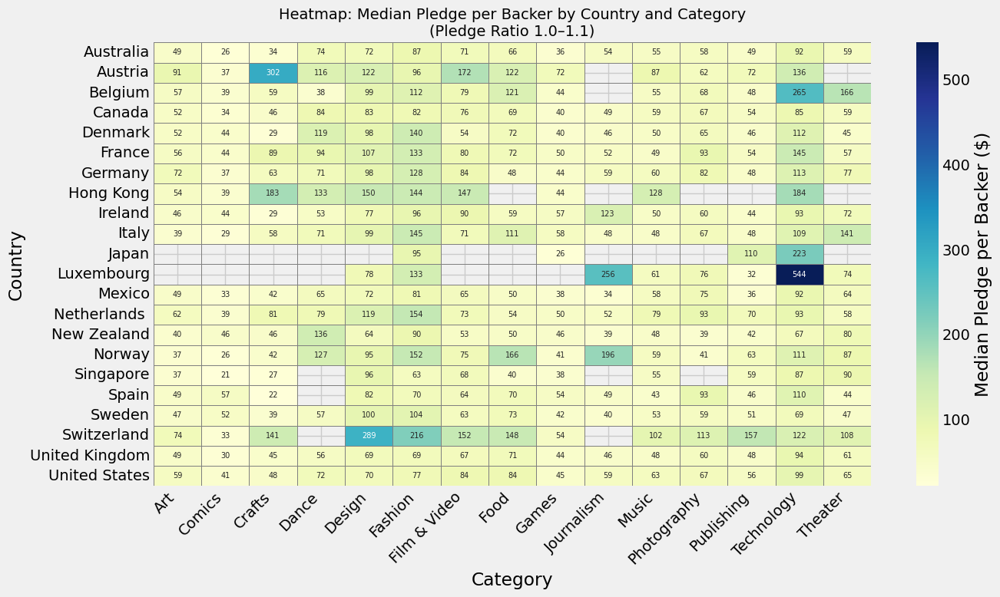

In [96]:
# Create pivot table: rows = countries, columns = categories (not subcategories), values = median(ave_backer)
heatmap_data_category = df_heatmap.pivot_table(
    index='country',
    columns='category',
    values='ave_backer',
    aggfunc='median'
)

# Plot heatmap with categories
plt.figure(figsize=(14, 8))
sns.heatmap(
    heatmap_data_category_ext,
    cmap='YlGnBu',
    linewidths=0.5,
    linecolor='gray',
    annot=True,
    fmt=".0f",  # Integer format
    annot_kws={"size": 7},
    cbar_kws={'label': 'Median Pledge per Backer ($)'}
)
plt.title("Heatmap: Median Pledge per Backer by Country and Category\n(Pledge Ratio 1.0–1.1)", fontsize=14)
plt.xlabel("Category")
plt.ylabel("Country")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

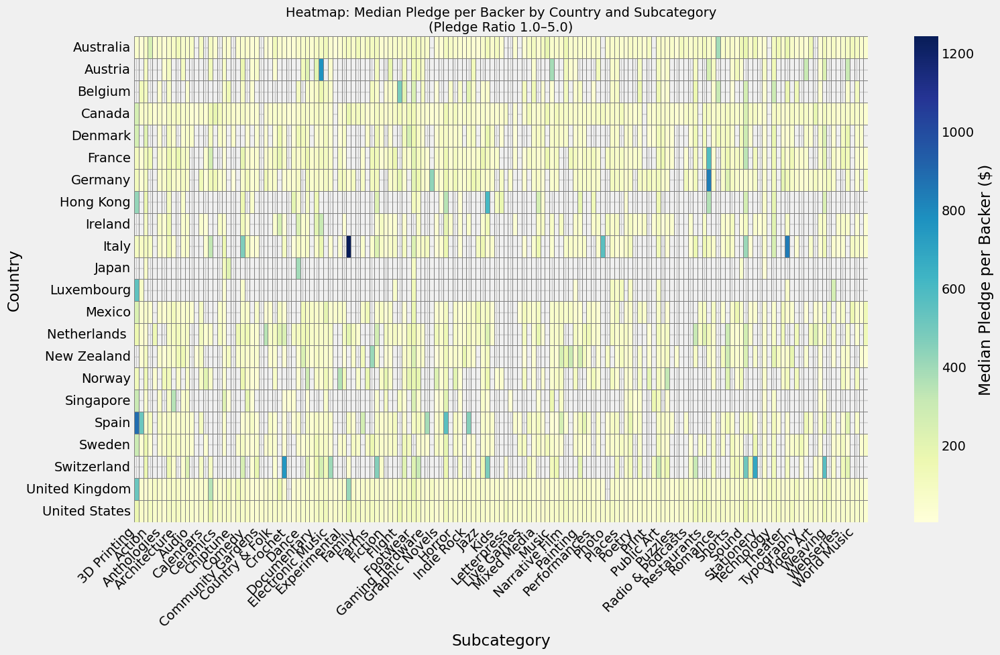

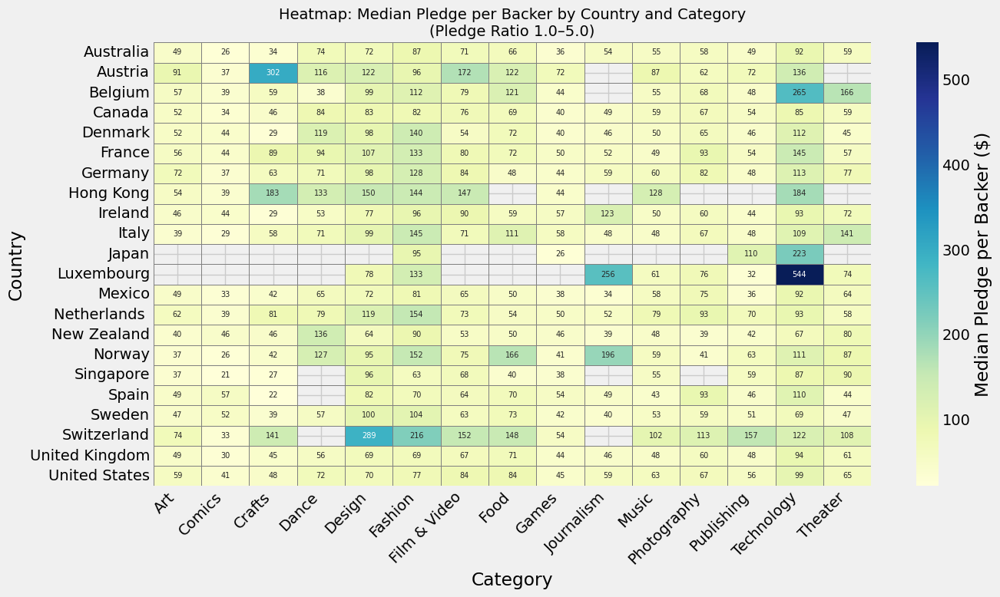

In [95]:
# Recompute necessary fields
df_clean['pledge_ratio'] = df_clean['pledged'] / df_clean['goal']
df_clean['ave_backer'] = df_clean['pledged'] / df_clean['backers']
df_clean['ave_backer'].replace([np.inf, -np.inf], np.nan, inplace=True)

# Filter for pledge_ratio between 1.0 and 1.1
df_heatmap = df_clean[
    (df_clean['pledge_ratio'] >= 1.0) &
    (df_clean['pledge_ratio'] <= 5.0)
].copy()

# Pivot table: country vs subcategory with median(ave_backer)
heatmap_data = df_heatmap.pivot_table(
    index='country',
    columns='subcategory',
    values='ave_backer',
    aggfunc='median'
)

# Plot the heatmap
plt.figure(figsize=(16, 10))
sns.heatmap(heatmap_data, cmap='YlGnBu', linewidths=0.5, linecolor='gray', annot=False, cbar_kws={'label': 'Median Pledge per Backer ($)'})
plt.title("Heatmap: Median Pledge per Backer by Country and Subcategory\n(Pledge Ratio 1.0–5.0)", fontsize=14)
plt.xlabel("Subcategory")
plt.ylabel("Country")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Create pivot table: rows = countries, columns = categories (not subcategories), values = median(ave_backer)
heatmap_data_category = df_heatmap.pivot_table(
    index='country',
    columns='category',
    values='ave_backer',
    aggfunc='median'
)

# Plot heatmap with categories
plt.figure(figsize=(14, 8))
sns.heatmap(
    heatmap_data_category_ext,
    cmap='YlGnBu',
    linewidths=0.5,
    linecolor='gray',
    annot=True,
    fmt=".0f",  # Integer format
    annot_kws={"size": 7},
    cbar_kws={'label': 'Median Pledge per Backer ($)'}
)

plt.title("Heatmap: Median Pledge per Backer by Country and Category\n(Pledge Ratio 1.0–5.0)", fontsize=14)
plt.xlabel("Category")
plt.ylabel("Country")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

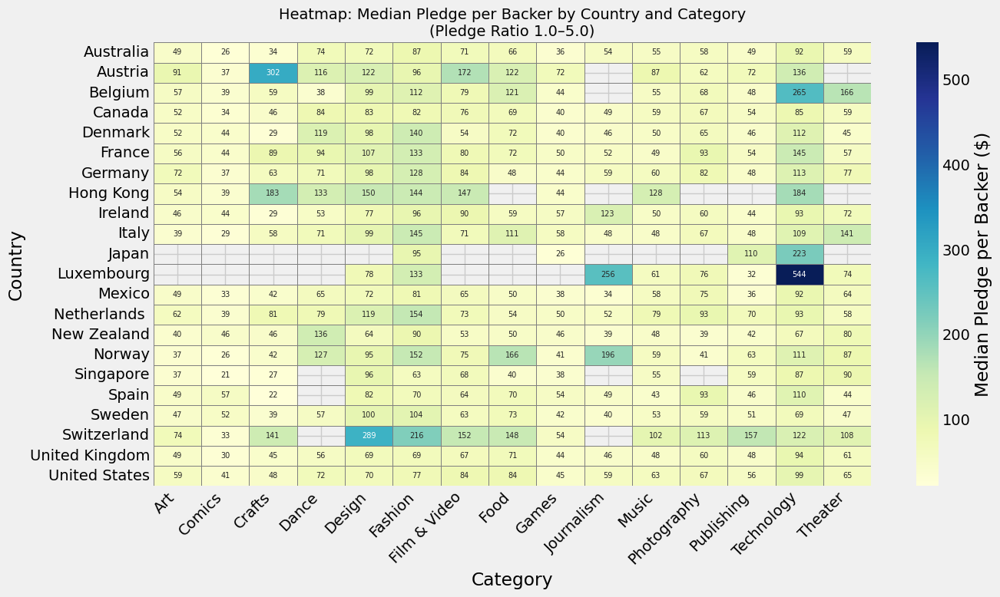

In [94]:
# Filter data for pledge_ratio between 1.0 and 5.0
df_heatmap_extended = df_clean[
    (df_clean['pledge_ratio'] >= 1.0) &
    (df_clean['pledge_ratio'] <= 5.0)
].copy()

# Recalculate ave_backer just in case
df_heatmap_extended['ave_backer'] = df_heatmap_extended['pledged'] / df_heatmap_extended['backers']
df_heatmap_extended['ave_backer'].replace([np.inf, -np.inf], np.nan, inplace=True)

# Create pivot table: country vs category, using median ave_backer
heatmap_data_category_ext = df_heatmap_extended.pivot_table(
    index='country',
    columns='category',
    values='ave_backer',
    aggfunc='median'
).round(0)  # Round to integer

# Plot heatmap with annotations as integers
plt.figure(figsize=(14, 8))
sns.heatmap(
    heatmap_data_category_ext,
    cmap='YlGnBu',
    linewidths=0.5,
    linecolor='gray',
    annot=True,
    fmt=".0f",  # Integer format
    annot_kws={"size": 7},
    cbar_kws={'label': 'Median Pledge per Backer ($)'}
)
plt.title("Heatmap: Median Pledge per Backer by Country and Category\n(Pledge Ratio 1.0–5.0)", fontsize=14)
plt.xlabel("Category")
plt.ylabel("Country")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

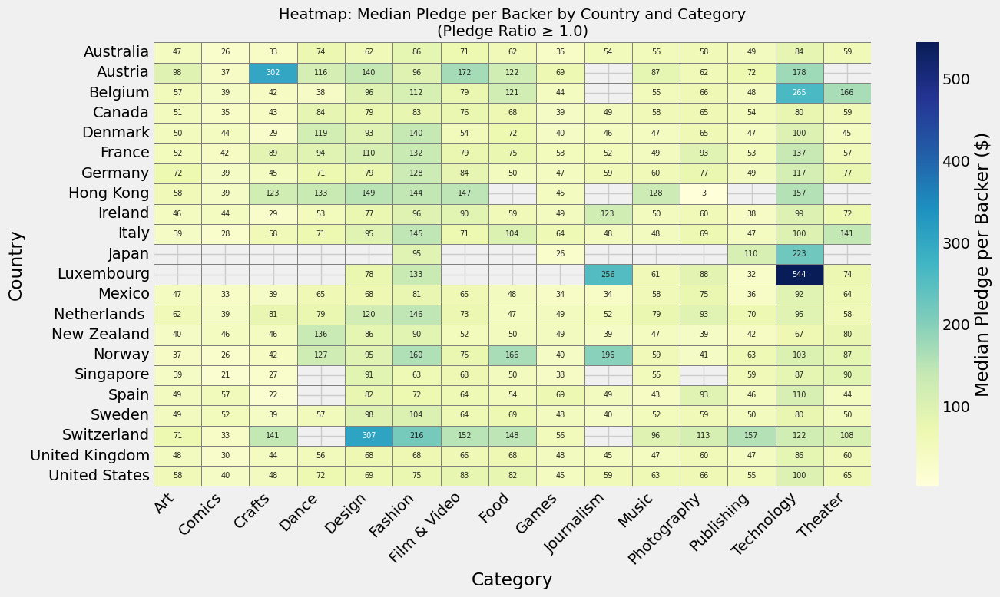

In [98]:
# Filter data for pledge_ratio >= 1.0
df_heatmap_all = df_clean[df_clean['pledge_ratio'] >= 1.0].copy()

# Recalculate ave_backer just in case
df_heatmap_all['ave_backer'] = df_heatmap_all['pledged'] / df_heatmap_all['backers']
df_heatmap_all['ave_backer'].replace([np.inf, -np.inf], np.nan, inplace=True)

# Create pivot table: country vs category, using median ave_backer
heatmap_data_all = df_heatmap_all.pivot_table(
    index='country',
    columns='category',
    values='ave_backer',
    aggfunc='median'
).round(0)  # Round to integer

# Plot heatmap with annotations as integers
plt.figure(figsize=(14, 8))
sns.heatmap(
    heatmap_data_all,
    cmap='YlGnBu',
    linewidths=0.5,
    linecolor='gray',
    annot=True,
    fmt=".0f",  # Integer format
    annot_kws={"size": 7},
    cbar_kws={'label': 'Median Pledge per Backer ($)'}
)
plt.title("Heatmap: Median Pledge per Backer by Country and Category\n(Pledge Ratio ≥ 1.0)", fontsize=14)
plt.xlabel("Category")
plt.ylabel("Country")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [71]:
df_clean.columns

Index(['id', 'name', 'category', 'subcategory', 'country', 'launched',
       'deadline', 'goal', 'pledged', 'backers', 'state', 'duration',
       'launch_month', 'launch_year', 'pledge_ratio', 'ave_backer',
       'backer_ratio_on_goal', 'duration_days', 'goal_bin'],
      dtype='object')

In [219]:
###
#duration_days
#pledge_ratio
#ave_backer
#backer_ratio_on_goal
###

In [ ]:
#Real Modelling - Subistitute the "state" with pledged_to_goal ratio by division of pledged and goal.Then show the number of projects for which the state ist between 1.0 and 1.1

In [75]:
# Calculate pledged-to-goal ratio and replace 0 goals with NaN to avoid division by zero
df['pledged_to_goal'] = df['pledged'] / df['goal'].replace(0, pd.NA)

# Replace 'state' with the pledged_to_goal ratio
df['state'] = df['pledged_to_goal']

# Count number of projects with a ratio between 1.0 and 1.1
count_ratio_1_0_to_1_1 = df[(df['state'] >= 1.0) & (df['state'] <= 1.1)].shape[0]
count_ratio_1_0_to_1_1

52556

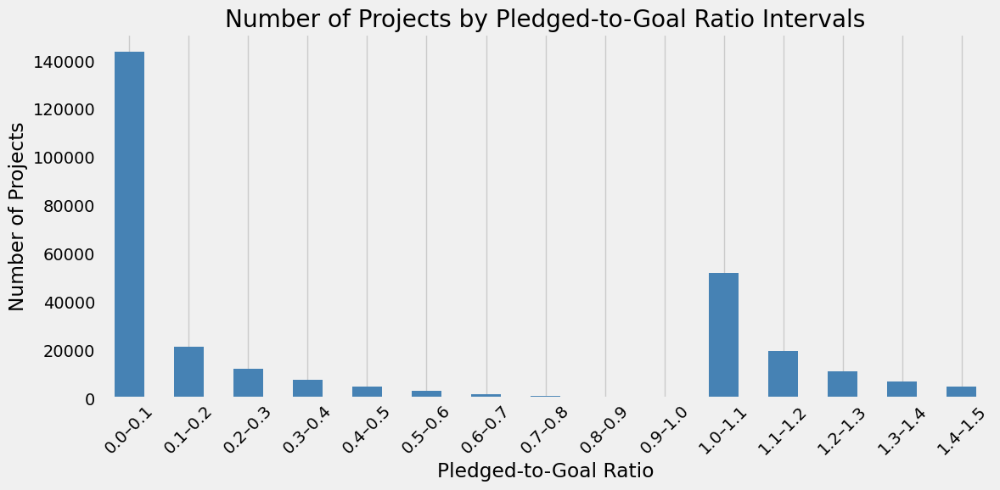

In [76]:
# Define bins for pledged-to-goal ratio from 0.0 to 1.0 in steps of 0.1
bins = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
labels = ['0.0–0.1', '0.1–0.2', '0.2–0.3', '0.3–0.4', '0.4–0.5',
          '0.5–0.6', '0.6–0.7', '0.7–0.8', '0.8–0.9', '0.9–1.0']

# Create a new column for the binned state
df['pledged_ratio_bin'] = pd.cut(df['state'], bins=bins, labels=labels, include_lowest=True, right=False)

# Count number of projects in each bin
bin_counts = df['pledged_ratio_bin'].value_counts().sort_index()

# Display the result
bin_counts
# Extend bins and labels to cover 1.0–1.5
extended_bins = bins + [1.1, 1.2, 1.3, 1.4, 1.5]
extended_labels = labels + ['1.0–1.1', '1.1–1.2', '1.2–1.3', '1.3–1.4', '1.4–1.5']

# Re-bin using extended range
df['pledged_ratio_bin'] = pd.cut(df['state'], bins=extended_bins, labels=extended_labels, include_lowest=True, right=False)

# Count projects in each bin
extended_bin_counts = df['pledged_ratio_bin'].value_counts().sort_index()

# Plot
plt.figure(figsize=(12, 6))
extended_bin_counts.plot(kind='bar', color='steelblue')
plt.title('Number of Projects by Pledged-to-Goal Ratio Intervals')
plt.xlabel('Pledged-to-Goal Ratio')
plt.ylabel('Number of Projects')
plt.xticks(rotation=45)
plt.tight_layout()
plt.grid(axis='y')
plt.show()

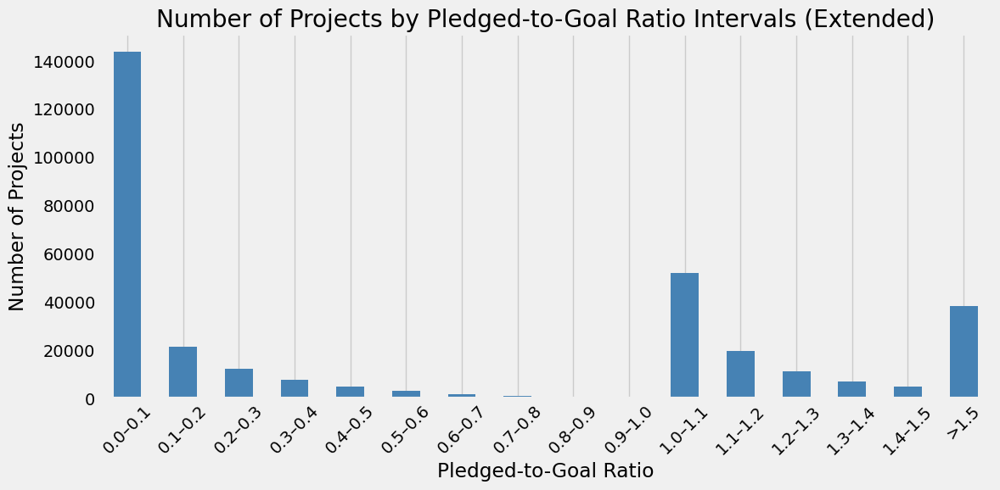

In [87]:
# Add one final bin for all ratios greater than or equal to 1.5
df['pledged_ratio_bin'] = pd.cut(
    df['state'],
    bins=extended_bins + [float('inf')],
    labels=extended_labels + ['>1.5'],
    include_lowest=True,
    right=False
)

# Count projects in each updated bin
final_bin_counts = df['pledged_ratio_bin'].value_counts().sort_index()

# Plot
plt.figure(figsize=(12, 6))
final_bin_counts.plot(kind='bar', color='steelblue')
plt.title('Number of Projects by Pledged-to-Goal Ratio Intervals (Extended)')
plt.xlabel('Pledged-to-Goal Ratio')
plt.ylabel('Number of Projects')
plt.xticks(rotation=45)
plt.tight_layout()
plt.grid(axis='y')
plt.show()

In [77]:
df.columns

Index(['id', 'name', 'category', 'subcategory', 'country', 'launched',
       'deadline', 'goal', 'pledged', 'backers', 'state', 'duration',
       'launch_month', 'launch_year', 'pledged_to_goal', 'pledged_ratio_bin'],
      dtype='object')

In [78]:
df.head()

,id,name,category,subcategory,country,launched,deadline,goal,pledged,backers,state,duration,launch_month,launch_year,pledged_to_goal,pledged_ratio_bin
0,1860890148,Grace Jones Does Not Give A F$#% T-Shirt (limi...,Fashion,Fashion,United States,2009-04-21 21:02:48,2009-05-31,1000,625,30,0.625000,39,4,2009,0.625000,0.6–0.7
1,709707365,CRYSTAL ANTLERS UNTITLED MOVIE,Film & Video,Shorts,United States,2009-04-23 00:07:53,2009-07-20,80000,22,3,0.000275,87,4,2009,0.000275,0.0–0.1
2,1703704063,drawing for dollars,Art,Illustration,United States,2009-04-24 21:52:03,2009-05-03,20,35,3,1.750000,8,4,2009,1.750000,NaN
3,727286,Offline Wikipedia iPhone app,Technology,Software,United States,2009-04-25 17:36:21,2009-07-14,99,145,25,1.464646,79,4,2009,1.464646,1.4–1.5
4,1622952265,Pantshirts,Fashion,Fashion,United States,2009-04-27 14:10:39,2009-05-26,1900,387,10,0.203684,28,4,2009,0.203684,0.2–0.3


In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Filter dataset for campaigns where pledged_to_goal (state) is between 1.0 and 1.1
df_filtered = df[(df['state'] >= 1.0) & (df['state'] <= 1.1)].copy()

#put the number of words in Name as a feature ?

# Select relevant features and target
features = ['goal', 'duration', 'launch_month', 'launch_year', 'category', 'subcategory', 'country']
target = 'backers'

# Drop rows with missing or zero goal (shouldn't be present after filtering, but just in case)
df_filtered = df_filtered[df_filtered['goal'] > 0].dropna(subset=features + [target])

# One-hot encode categorical variables
df_model = pd.get_dummies(df_filtered[features + [target]], drop_first=True)

# Split features and target
X = df_model.drop(columns=[target])
y = df_model[target]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train Linear Regression model
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Make predictions and evaluate
y_pred = lr_model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
rmse = mean_squared_error(y_test, y_pred, squared=False)
r2 = r2_score(y_test, y_pred)

mae, rmse, r2

(47.87588515022418, 116.2468296588666, 0.47840644225269435)

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_log_error, median_absolute_error, max_error, mean_poisson_deviance


# Define parameter grid for Linear Regression (limited since it's a simple model)
# For demonstration: we use Ridge (L2-regularized linear regression) to allow tuning of alpha
from sklearn.linear_model import Ridge

# Parameter grid for Ridge regression
param_grid = {
    'alpha': [0.01, 0.1, 1.0, 10.0, 100.0]
}

# Setup GridSearch with 5-fold cross-validation
ridge = Ridge()
grid_search = GridSearchCV(estimator=ridge, param_grid=param_grid, cv=5, scoring='neg_mean_absolute_error')
grid_search.fit(X_train, y_train)

# Best model evaluation
best_ridge = grid_search.best_estimator_
y_pred_best = best_ridge.predict(X_test)

# Calculate performance metrics for best model
mae_best = mean_absolute_error(y_test, y_pred_best)
rmse_best = mean_squared_error(y_test, y_pred_best, squared=False)
r2_best = r2_score(y_test, y_pred_best)

grid_search.best_params_, mae_best, rmse_best, r2_best

# Compute only the metrics that are safe and relevant here
medae = median_absolute_error(y_test, y_pred_best)
maxe = max_error(y_test, y_pred_best)
print("FIRST ROUND RESULTS: (W/O number of words)")
{
    'Median Absolute Error': medae,
    'Max Error': maxe
}

{'Median Absolute Error': 21.61934608931506, 'Max Error': 3618.330009772385}

In [99]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, FunctionTransformer
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

# Reload the filtered dataset
df_filtered = df[(df['state'] >= 1.0) & (df['state'] <= 1.1)].copy()

# Add new feature: number of words in title
df_filtered['title_word_count'] = df_filtered['name'].fillna('').apply(lambda x: len(str(x).split()))

# Define features and target
features = ['goal', 'duration', 'launch_month', 'launch_year',
            'category', 'subcategory', 'country', 'title_word_count']
target = 'backers'

# Drop rows with missing essential data
df_filtered = df_filtered[df_filtered['goal'] > 0].dropna(subset=features + [target])

# Split into X and y
X = df_filtered[features]
y = df_filtered[target]

# Identify categorical and numeric features
categorical_features = ['category', 'subcategory', 'country']
numeric_features = ['goal', 'duration', 'launch_month', 'launch_year', 'title_word_count']

# Correcting for older scikit-learn version: use 'sparse=False' instead of 'sparse_output'
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_features),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False), categorical_features)
])

# Use Ridge with a safe solver
ridge = Ridge(solver='auto')

# Build pipeline
pipeline = Pipeline([
    ('preprocessing', preprocessor),
    ('regressor', ridge)
])

# Grid search hyperparameters
param_grid = {
    'regressor__alpha': [0.01, 0.1, 1.0, 10.0, 100.0]
}

# Run grid search
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='neg_mean_absolute_error')
grid_search.fit(X, y)

# Evaluate best model
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_
y_pred_best = best_model.predict(X)
mae_best = mean_absolute_error(y, y_pred_best)
rmse_best = mean_squared_error(y, y_pred_best, squared=False)
r2_best = r2_score(y, y_pred_best)

best_params, mae_best, rmse_best, r2_best

({'regressor__alpha': 100.0},
 46.184347738774264,
 124.98564170633418,
 0.6403731789882825)

In [102]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import make_scorer

# Create new pipeline using RandomForestRegressor
rf_pipeline = Pipeline([
    ('preprocessing', preprocessor),
    ('regressor', RandomForestRegressor(random_state=42))
])

# Set parameter grid for tuning (small for speed, can expand later)
rf_param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [None, 10, 20],
    'regressor__min_samples_split': [2, 5]
}

# Define multiple scoring metrics
scoring_metrics = {
    'MAE': make_scorer(mean_absolute_error, greater_is_better=False),
    'RMSE': make_scorer(mean_squared_error, greater_is_better=False, squared=False),
    'R2': make_scorer(r2_score)
}

# Set up grid search with RandomForest
rf_grid_search = GridSearchCV(
    rf_pipeline,
    param_grid=rf_param_grid,
    cv=3,
    scoring='neg_mean_absolute_error',  # primary scoring
    refit='neg_mean_absolute_error',
    return_train_score=True,
    n_jobs=-1
)

# Fit the model
rf_grid_search.fit(X, y)

# Best model evaluation
rf_best_model = rf_grid_search.best_estimator_
y_pred_rf = rf_best_model.predict(X)

# Calculate evaluation metrics
mae_rf = mean_absolute_error(y, y_pred_rf)
rmse_rf = mean_squared_error(y, y_pred_rf, squared=False)
r2_rf = r2_score(y, y_pred_rf)
medae_rf = median_absolute_error(y, y_pred_rf)
maxe_rf = max_error(y, y_pred_rf)

{
    'Best Parameters': rf_grid_search.best_params_,
    'MAE': mae_rf,
    'RMSE': rmse_rf,
    'R2 Score': r2_rf,
    'Median Absolute Error': medae_rf,
    'Max Error': maxe_rf
}

{'Best Parameters': {'regressor__max_depth': 10,
  'regressor__min_samples_split': 2,
  'regressor__n_estimators': 200},
 'MAE': 37.46575092717947,
 'RMSE': 78.05854278123829,
 'R2 Score': 0.8597274460317844,
 'Median Absolute Error': 18.223306680576243,
 'Max Error': 2743.504999999999}

In [105]:
# Re-import necessary packages due to code execution reset
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, median_absolute_error, max_error

# Reload dataset
df = pd.read_csv("../data/kickstarter_common.csv")

# Preprocess base features
df['pledged_to_goal'] = df['pledged'] / df['goal'].replace(0, pd.NA)
df['state'] = df['pledged_to_goal']
df['title_word_count'] = df['name'].fillna('').apply(lambda x: len(str(x).split()))

# Filter to near-successful campaigns
df_filtered = df[(df['state'] >= 1.0) & (df['state'] <= 1.1)].copy()

# Define features/target
features = ['goal', 'duration', 'launch_month', 'launch_year',
            'category', 'subcategory', 'country', 'title_word_count']
target = 'backers'
df_filtered = df_filtered[df_filtered['goal'] > 0].dropna(subset=features + [target])
X = df_filtered[features]
y = df_filtered[target]

# Train/test split and sample for faster fitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_sample, _, y_sample, _ = train_test_split(X_train, y_train, train_size=3000, random_state=42)

# Define preprocessing
categorical_features = ['category', 'subcategory', 'country']
numeric_features = ['goal', 'duration', 'launch_month', 'launch_year', 'title_word_count']

preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_features),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False), categorical_features)
])

# Define and fit pipeline
rf_pipeline = Pipeline([
    ('preprocessing', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=100, max_depth=10, n_jobs=1, random_state=42))
])
rf_pipeline.fit(X_sample, y_sample)

# Extract feature importances
rf_model = rf_pipeline.named_steps['regressor']
ohe = rf_pipeline.named_steps['preprocessing'].named_transformers_['cat']
cat_feature_names = ohe.get_feature_names_out(categorical_features)
all_feature_names = numeric_features + list(cat_feature_names)

importances = rf_model.feature_importances_
feature_importance_df = pd.DataFrame({
    'Feature': all_feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

feature_importance_df.head(10)


,Feature,Importance
0,goal,0.897507
1,duration,0.011431
4,title_word_count,0.011237
3,launch_year,0.009650
2,launch_month,0.009521
12,category_Games,0.008927
145,subcategory_Video Games,0.008396
34,subcategory_Civic Design,0.005060
48,subcategory_Design,0.002850
149,subcategory_Webseries,0.002646
